# <span style="color: teal;">Task 1- Exploratory Data Analysis on Global Terrorism(1970-2017).</span>

 This EDA was done by Suvam Sekhar Dash as part of his internship with CodersCave.

## <span style="color: teal;"> Objective</span>

By using EDA to identify the hot zones of terrorism and derive security issues and insights, we can help to prevent terrorist attacks and protect our community.

## <span style="color: teal;"> What this data set is all about?</span>

1-Consists of Information about more than 180,000 Terrorist Attacks.

2-Includes information about terrorist attacks around the world from 1970 to 2017.

3-Includes systematic data on domestic as well as international terrorist incidents that have occurred during specific time period.

In [1]:
pip install wordcloud


Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install pandoc

Note: you may need to restart the kernel to use updated packages.


## <span style="color: teal;"> Importing The Python Libraries</span>

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import warnings
warnings.filterwarnings('ignore')
import os
import plotly.graph_objects as go
import plotly.express as px

import nltk
nltk.download('words')


[nltk_data] Downloading package words to
[nltk_data]     C:\Users\Lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


True

## <span style="color: teal;"> Importing The Dataset</span>


In [4]:
df1 = pd.read_csv(r"C:\Users\Lenovo\OneDrive\Desktop\Datasets\CodersCave\global terrorisms.csv")
df1

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,1.970000e+11,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,1.970000e+11,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,1.970010e+11,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,1.970010e+11,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,1.970010e+11,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2.017120e+11,2017,12,31,NaN,0,NaN,182,Somalia,11,...,NaN,"""Somalia: Al-Shabaab Militants Attack Army Che...","""Highlights: Somalia Daily Media Highlights 2 ...","""Highlights: Somalia Daily Media Highlights 1 ...",START Primary Collection,0,0,0,0,NaN
181687,2.017120e+11,2017,12,31,NaN,0,NaN,200,Syria,10,...,NaN,"""Putin's 'victory' in Syria has turned into a ...","""Two Russian soldiers killed at Hmeymim base i...","""Two Russian servicemen killed in Syria mortar...",START Primary Collection,-9,-9,1,1,NaN
181688,2.017120e+11,2017,12,31,NaN,0,NaN,160,Philippines,5,...,NaN,"""Maguindanao clashes trap tribe members,"" Phil...",NaN,NaN,START Primary Collection,0,0,0,0,NaN
181689,2.017120e+11,2017,12,31,NaN,0,NaN,92,India,6,...,NaN,"""Trader escapes grenade attack in Imphal,"" Bus...",NaN,NaN,START Primary Collection,-9,-9,0,-9,NaN


## <span style="color: teal;">Getting Top 5 Rows Of The DataFrame</span>

In [5]:
df1.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,1.970000e+11,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,1.970000e+11,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,1.970010e+11,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,1.970010e+11,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,1.970010e+11,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


## <span style="color: teal;">Getting Info About All The Columns In DataFrame</span>

In [6]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(56), int64(21), object(58)
memory usage: 187.1+ MB


In [7]:
df1.dtypes

eventid       float64
iyear           int64
imonth          int64
iday            int64
approxdate     object
               ...   
INT_LOG         int64
INT_IDEO        int64
INT_MISC        int64
INT_ANY         int64
related        object
Length: 135, dtype: object

In [8]:
df1.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [9]:
df1.shape

(181691, 135)

## <span style="color: teal;"> Checking For Missing Values In The DataFrame</span>

In [10]:
df1.isnull().sum()

eventid            0
iyear              0
imonth             0
iday               0
approxdate    172452
               ...  
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
related       156653
Length: 135, dtype: int64

## <span style="color: teal;"> Renaming & Selecting columns which we want to analyze</span>

In [11]:
df1.rename(columns={'iyear':'Year','imonth':'Month','iday':'Day','country_txt':'Country',
                       'region_txt':'Region','attacktype1_txt':'AttackType','target1':'Target',
                       'nkill':'Killed','nwound':'Wounded','summary':'Summary','gname':'Group',
                       'targtype1_txt':'Target_type','weaptype1_txt':'Weapon_type','motive':'Motive'},inplace=True)
df=df1[['Year','Month','Day','Country','Region','city','latitude','longitude','AttackType',
               'Killed','Wounded','Target','Summary','Group','Target_type','Weapon_type','Motive']]

# concatinating the columns killed and wounded
df["Killed"]=df["Killed"].fillna(0)
df["Wounded"]=df["Wounded"].fillna(0)
df["Casualty"]=df["Killed"]+df["Wounded"]
df

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,Casualty
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0
2,1970,1,0,Philippines,Southeast Asia,Unknown,15.478598,120.599741,Assassination,1.0,0.0,Employee,NaN,Unknown,Journalists & Media,Unknown,NaN,1.0
3,1970,1,0,Greece,Western Europe,Athens,37.997490,23.762728,Bombing/Explosion,0.0,0.0,U.S. Embassy,NaN,Unknown,Government (Diplomatic),Explosives,NaN,0.0
4,1970,1,0,Japan,East Asia,Fukouka,33.580412,130.396361,Facility/Infrastructure Attack,0.0,0.0,U.S. Consulate,NaN,Unknown,Government (Diplomatic),Incendiary,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,2017,12,31,Somalia,Sub-Saharan Africa,Ceelka Geelow,2.359673,45.385034,Armed Assault,1.0,2.0,Checkpoint,12/31/2017: Assailants opened fire on a Somali...,Al-Shabaab,Military,Firearms,NaN,3.0
181687,2017,12,31,Syria,Middle East & North Africa,Jableh,35.407278,35.942679,Bombing/Explosion,2.0,7.0,Hmeymim Air Base,12/31/2017: Assailants launched mortars at the...,Muslim extremists,Military,Explosives,NaN,9.0
181688,2017,12,31,Philippines,Southeast Asia,Kubentog,6.900742,124.437908,Facility/Infrastructure Attack,0.0,0.0,Houses,12/31/2017: Assailants set fire to houses in K...,Bangsamoro Islamic Freedom Movement (BIFM),Private Citizens & Property,Incendiary,NaN,0.0
181689,2017,12,31,India,South Asia,Imphal,24.798346,93.940430,Bombing/Explosion,0.0,0.0,Office,12/31/2017: Assailants threw a grenade at a Fo...,Unknown,Government (General),Explosives,NaN,0.0


## <span style="color: olive;">  Exploring the data using Data Visualisation.</span>

## <span style="color: teal;"> Q-1 Which country had faced the highest no of terrorist attacks?</span>

In [12]:
df.Country.value_counts()[:10]

Iraq              24636
Pakistan          14368
Afghanistan       12731
India             11960
Colombia           8306
Philippines        6908
Peru               6096
El Salvador        5320
United Kingdom     5235
Turkey             4292
Name: Country, dtype: int64

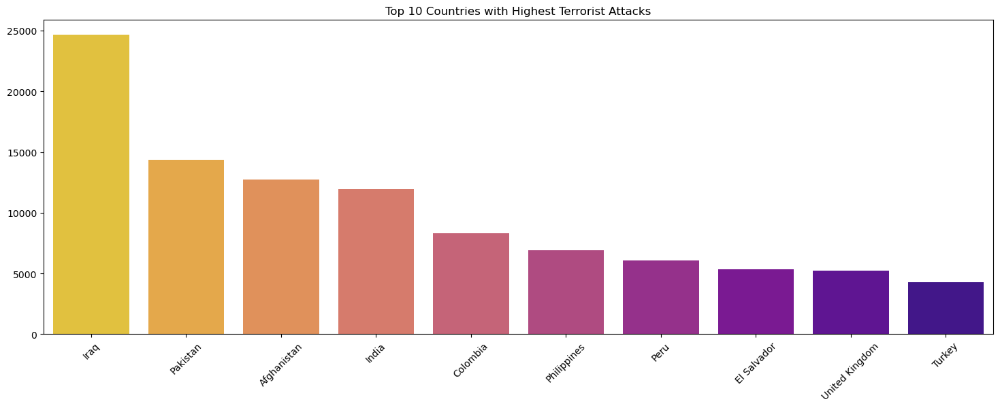

In [13]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df['Country'].value_counts()[:10].index, y=df['Country'].value_counts()[:10].values, palette='plasma_r')
plt.title('Top 10 Countries with Highest Terrorist Attacks')
plt.xticks(rotation=45)
plt.show()

##  <span style="color: maroon;">Observations:-</span>

1) Iraq with 24636 terrorist attacks has been ranked 1st Position in the list of countries with Highest no of Terrorist Attacks followed by Pakistan(2nd) with 14368 terrorist attacks, Afghanistan(3rd)with 12731 terrorist attacks,India(4th)with 11960 terrorist attacks, Colombia (5th) with 8306 terrorist attacks during the period (1970-2017)

    



2) Iraq, Pakistan, Afghanistan & India are the only countries in the world which faced more than 10,000+ terrorist attacks during the period of 1970-2017.


## <span style="color: teal;"> Which region had highest terrorirst attacks?</span>

In [14]:
df.Region.value_counts()[:10]

Middle East & North Africa     50474
South Asia                     44974
South America                  18978
Sub-Saharan Africa             17550
Western Europe                 16639
Southeast Asia                 12485
Central America & Caribbean    10344
Eastern Europe                  5144
North America                   3456
East Asia                        802
Name: Region, dtype: int64

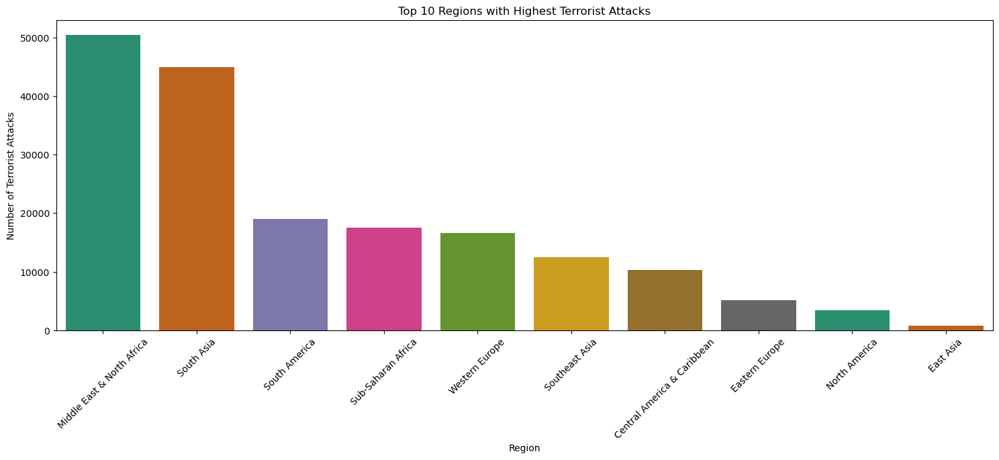

In [15]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df['Region'].value_counts()[:10].index, y=df['Region'].value_counts()[:10].values, palette='Dark2')
plt.title('Top 10 Regions with Highest Terrorist Attacks')
plt.xticks(rotation=45)
plt.xlabel('Region')
plt.ylabel('Number of Terrorist Attacks')
plt.show()

## <span style="color: maroon;">Observations:-</span>

1)  Middle East & North Africa region and South Asia region faced more than 40,000+ terrorist attacks in the period between 1970-2017.

 

2)  After Middle East & North Africa region and South Asia region,South America region,Sub-Saharan Africa Region, Western Europe Region, Southeast Asia Region,Central America & Caribbean Region faced more than 10,000+ terrorist attacks in the period between 1970-2017. 

## <span style="color: teal;"> Which  weapons were most frequently used by terrorists ?</span>

In [16]:
df.Weapon_type.value_counts()[:10]

Explosives                                                                     92426
Firearms                                                                       58524
Unknown                                                                        15157
Incendiary                                                                     11135
Melee                                                                           3655
Chemical                                                                         321
Sabotage Equipment                                                               141
Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)      136
Other                                                                            114
Biological                                                                        35
Name: Weapon_type, dtype: int64

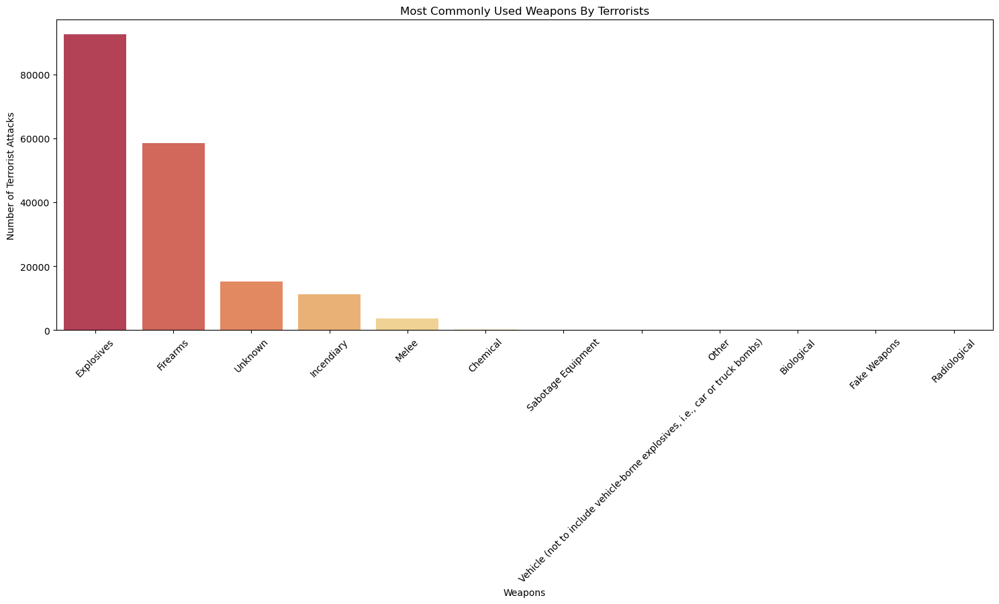

In [17]:

plt.subplots(figsize=(18, 6))
sns.barplot(x=df['Weapon_type'].value_counts().index, y=df['Weapon_type'].value_counts().values, palette='Spectral')
plt.title('Most Commonly Used Weapons By Terrorists')
plt.xticks(rotation=45)
plt.xlabel('Weapons')
plt.ylabel('Number of Terrorist Attacks')
plt.show()

## <span style="color: maroon;">Observations:-</span>

The figure shows that Explosives ,Firearms, Incendiary are most commonly used weapons used by terrorists for carrying out terrorist attack.

## <span style="color: teal;"> Which are the most common types of Terrorist attacks?</span>

In [18]:
df.AttackType.value_counts()

Bombing/Explosion                      88255
Armed Assault                          42669
Assassination                          19312
Hostage Taking (Kidnapping)            11158
Facility/Infrastructure Attack         10356
Unknown                                 7276
Unarmed Assault                         1015
Hostage Taking (Barricade Incident)      991
Hijacking                                659
Name: AttackType, dtype: int64

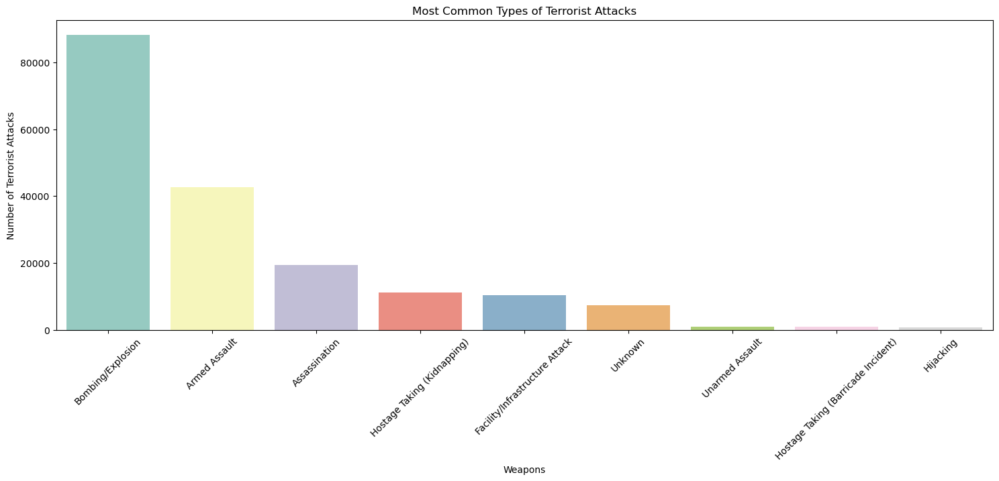

In [19]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df['AttackType'].value_counts().index, y=df['AttackType'].value_counts().values, palette='Set3')
plt.title('Most Common Types of Terrorist Attacks')
plt.xticks(rotation=45)
plt.xlabel('Weapons')
plt.ylabel('Number of Terrorist Attacks')
plt.show()

## <span style="color: maroon;">Observations:-</span>

1) Most of the terrorist groups preffer to carry out Bombing/Explosion to spread Terrorism. 


2) After Bombing/Explosion, terrorist groups use Armed Assault and Assaniation to spread Terrorism.

## <span style="color: teal;">Who were the targets of Terrorist Groups?</span>

In [20]:
df.Target_type.value_counts()

Private Citizens & Property       43511
Military                          27984
Police                            24506
Government (General)              21283
Business                          20669
Transportation                     6799
Utilities                          6023
Unknown                            5898
Religious Figures/Institutions     4440
Educational Institution            4322
Government (Diplomatic)            3573
Terrorists/Non-State Militia       3039
Journalists & Media                2948
Violent Political Party            1866
Airports & Aircraft                1343
Telecommunication                  1009
NGO                                 970
Tourists                            440
Maritime                            351
Food or Water Supply                317
Abortion Related                    263
Other                               137
Name: Target_type, dtype: int64

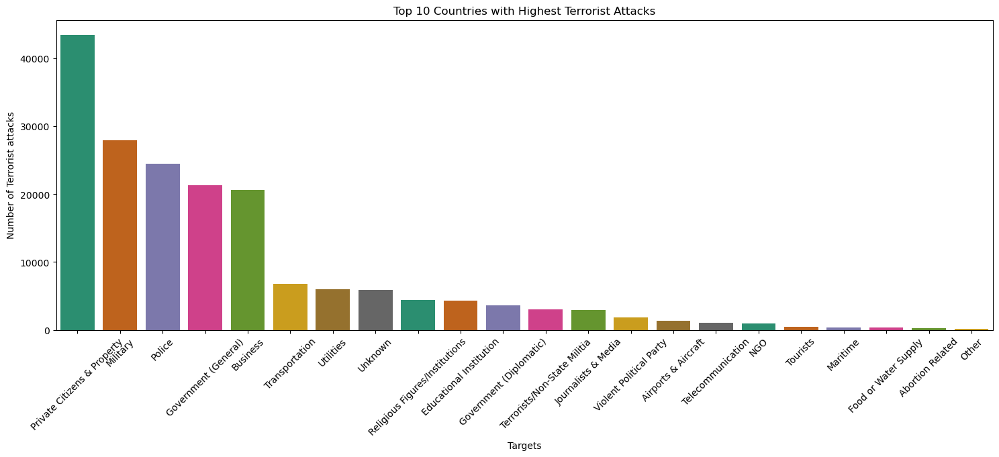

In [21]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df['Target_type'].value_counts().index, y=df['Target_type'].value_counts().values, palette='Dark2')
plt.title('Top 10 Countries with Highest Terrorist Attacks')
plt.xticks(rotation=45)
plt.xlabel('Targets')
plt.ylabel('Number of Terrorist attacks')
plt.show()

## <span style="color: maroon;">Observations:-</span>

Private Citizens & Property ,Military , Police, Government & Business Organisations were mostly targeted by the terrorist groups.

## <span style="color: teal;">Which Terrorist Groups which had carried out most terrorist attacks between 1970 and 2017?</span>


In [22]:
df.Group.value_counts()[:10]

Unknown                                             82782
Taliban                                              7478
Islamic State of Iraq and the Levant (ISIL)          5613
Shining Path (SL)                                    4555
Farabundo Marti National Liberation Front (FMLN)     3351
Al-Shabaab                                           3288
New People's Army (NPA)                              2772
Irish Republican Army (IRA)                          2671
Revolutionary Armed Forces of Colombia (FARC)        2487
Boko Haram                                           2418
Name: Group, dtype: int64

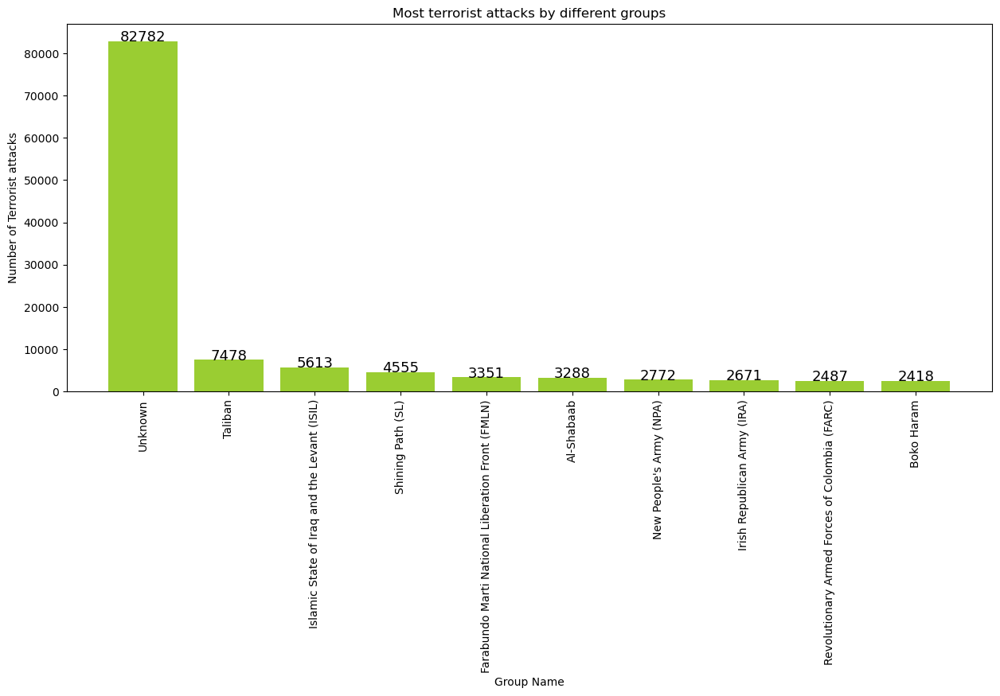

In [23]:
plt.figure(figsize=(15,6))
plt.bar(df.Group.value_counts()[:10].index,df.Group.value_counts()[:10].values,color='yellowgreen')
# set the axis labels and title
plt.xlabel('Group Name')
plt.ylabel('Number of Terrorist attacks')
plt.title('Most terrorist attacks by different groups')

# # rotate the x-axis labels for better visibility
plt.xticks(rotation=90)
for i, v in enumerate(df.Group.value_counts()[:10].values):
    plt.text(df.Group.value_counts()[:10].index[i], v+0.2, str(round(v,2)), fontsize=13, color='black', ha='center')
# show the plot
plt.show()

## <span style="color: maroon;"> Observations:-</span>

1) Unknown Terrorist Groups had carried out the most terrorist attacks in the period of 1970-2017.


2) While Taliban leads the chart with 7478 attacks followed by Islamic State of Iraq and the Levant with 5613 attacks among the known terrorist groups.

## <span style="color: teal;">No Terrorism attacks occurred each year between(1970-2017)</span>

In [24]:
highest_values = df1.groupby(['Year'])['eventid'].count()
highest_values

Year
1970      651
1971      471
1972      568
1973      473
1974      581
1975      740
1976      923
1977     1319
1978     1526
1979     2662
1980     2662
1981     2586
1982     2544
1983     2870
1984     3495
1985     2915
1986     2860
1987     3183
1988     3721
1989     4324
1990     3887
1991     4683
1992     5071
1994     3456
1995     3081
1996     3058
1997     3197
1998      934
1999     1395
2000     1814
2001     1906
2002     1333
2003     1278
2004     1166
2005     2017
2006     2758
2007     3242
2008     4805
2009     4721
2010     4826
2011     5076
2012     8522
2013    12036
2014    16903
2015    14965
2016    13587
2017    10900
Name: eventid, dtype: int64

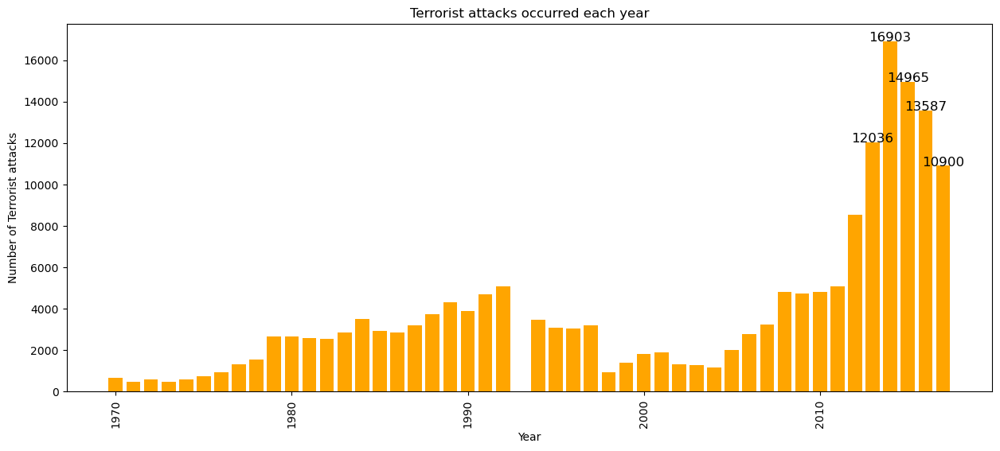

In [25]:
plt.figure(figsize=(15,6))
plt.bar(highest_values.index, highest_values.values,color='orange')
# set the axis labels and title
plt.xlabel('Year')
plt.ylabel('Number of Terrorist attacks')
plt.title('Terrorist attacks occurred each year')

# # rotate the x-axis labels for better visibility
plt.xticks(rotation=90)
for i, v in enumerate(highest_values.values):
    if v > 10000:
        plt.text(highest_values.index[i], v+0.2, str(round(v,2)), fontsize=12, color='black', ha='center')
# show the plot
plt.show()

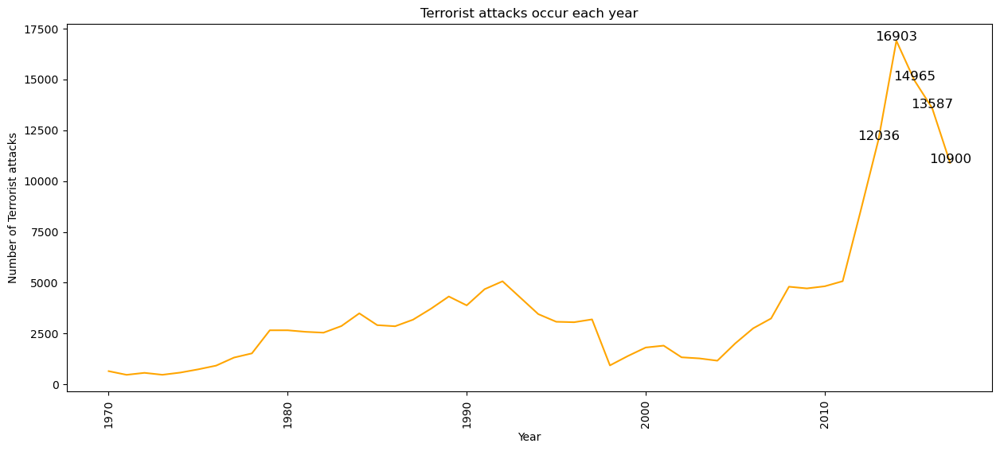

In [26]:
plt.figure(figsize=(15,6))
# plt.bar(highest_values.index, highest_values.values,color='mediumslateblue')
plt.plot(highest_values.index, highest_values.values, color="ORANGE")
# set the axis labels and title
plt.xlabel('Year')
plt.ylabel('Number of Terrorist attacks')
plt.title('Terrorist attacks occur each year')

# # rotate the x-axis labels for better visibility
plt.xticks(rotation=90)
for i, v in enumerate(highest_values.values):
    if v > 10000:
        plt.text(highest_values.index[i], v+0.2, str(round(v,2)), fontsize=12, color='black', ha='center')

## <span style="color: maroon;">Observations:-</span>

1) There is a huge rise in terrorist attacks after the year 2011.


2) The highest no of terrorist attacks occured in the year 2014 followed by 2015, 2016, 2013 and 2017.

## <span style="color: teal;">What drives terrorists to commit acts of violence?</span>

In [27]:
df1 = df[df['Motive'].notna()]
df1['Motive']

5            To protest the Cairo Illinois Police Deparment
8               To protest the War in Vietnam and the draft
9               To protest the War in Vietnam and the draft
11                        Protest the draft and Vietnam War
14        To protest United States owned businesses in P...
                                ...                        
181663    The specific motive is unknown; however, sourc...
181665    The specific motive is unknown; however, sourc...
181672    The specific motive is unknown; however, sourc...
181682    The specific motive is unknown; however, sourc...
181683    The specific motive is unknown; however, sourc...
Name: Motive, Length: 50561, dtype: object

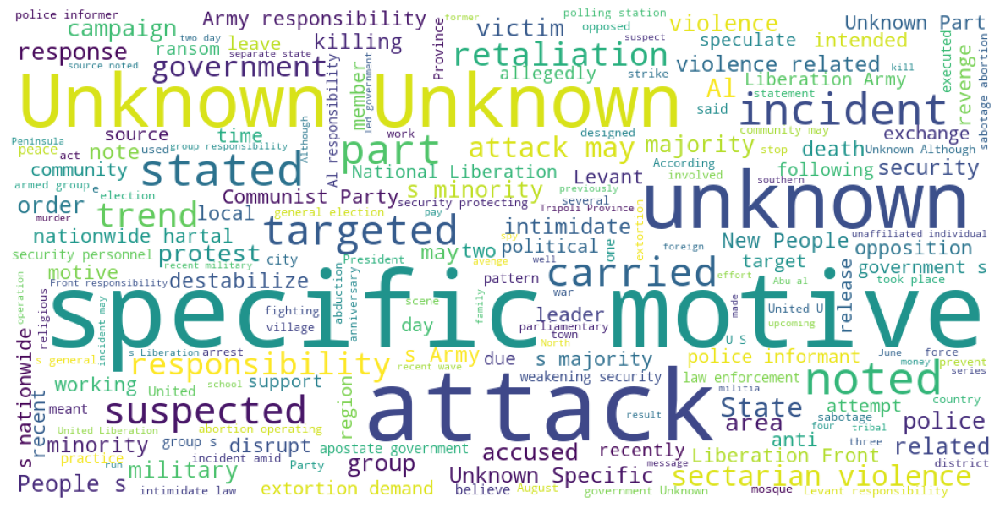

In [28]:

# Removing irrelevant words in clean_t column

words = set(nltk.corpus.words.words())

def clean_sent(sent):
    return " ".join(w for w in nltk.wordpunct_tokenize(sent) \
     if w.lower() in words or not w.isalpha())

df1['Motive'] = df1['Motive'].apply(clean_sent)
south_df = df_new = df1[df1['Motive'].notnull()].reset_index()

ingredients = []
for i in range(0,len(south_df)):
    text = south_df['Motive'][i].split(',')
    text = ','.join(text)
    ingredients.append(text)
    text = ' '.join(ingredients)
    
wordcloud = WordCloud(width = 1000, height = 500,background_color ='white',min_font_size = 10).generate(text)                  
plt.figure(figsize = (15, 8), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis('off') 
plt.show()

## <span style="color: teal;">Number of terrorist activities occured in region with respect to year</span>

In [29]:
fig_bar = px.histogram(df, x=["Region"], y=df['Killed'],
                 animation_frame="Year",
                 color_discrete_sequence=px.colors.qualitative.Pastel1)
fig_bar.update_yaxes(showgrid=False),
fig_bar.update_xaxes(categoryorder='total descending')
fig_bar.update_traces(hovertemplate=None)
fig_bar.update_layout(margin=dict(t=60, b=0, l=60, r=40),
                        hovermode="x unified",
                        xaxis_tickangle=45,
                        xaxis_title='Region ', yaxis_title="No Of Terror Activities  ",
                        plot_bgcolor='white', paper_bgcolor='white',
                        title_font=dict(size=25, color='grey', family="Lato, sans-serif"),
                        font=dict(color='black'),
                        legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1)
                     )
fig_bar.show()


## <span style="color: olive;">Detailed Comparison Of Terrorist Attacks Before And After 2011.</span>

In [30]:
new_row = pd.DataFrame(data = {
    'Period' : ['1970-2011','2011-2017'],
    'Terrorist Attacks' : [df[df.Year < 2011].shape[0],df[df.Year >= 2011].shape[0]]
})
new_row = new_row.set_index('Period','Terrorist Attacks')
new_row

,Terrorist Attacks
Period,
1970-2011,99702
2011-2017,81989


<Axes: ylabel='Terrorist Attacks'>

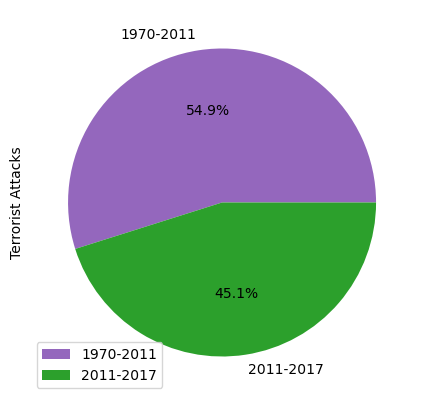

In [31]:
new_row.plot.pie(y='Terrorist Attacks', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=[  '#9467bd', '#2ca02c'])

## <span style="color: maroon;">Observations:-</span>

Approx 55% terrorist attacks were happened between 1970 -2011 but the next 45% of terrorist attacks were happened within 7 years only. That means Terrorist Groups became more aggresive after 2011.

# <span style="color: olive;">  Analysis of terrorist attacks after 2011</span>

In [32]:
df2 = df[df.Year > 2011]
df2.head(2)

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,Casualty
104778,2012,1,1,Pakistan,South Asia,Quetta,30.200819,66.994354,Bombing/Explosion,0.0,12.0,Paan Shop,01/01/2012: A grenade was thrown into a shop o...,Unknown,Business,Explosives,NaN,12.0
104779,2012,1,1,Kenya,Sub-Saharan Africa,Garissa,-0.456120,39.646123,Armed Assault,3.0,14.0,Bar,01/01/2012: Assailants threw two grenades and ...,Al-Shabaab,Business,Explosives,"The specific motive is unknown; however, Al-Sh...",17.0


## <span style="color: teal;">Which country faced the highest number of terrorist attacks after 2011?</span>

In [33]:
df2.Country.value_counts()[:10]

Iraq           16799
Afghanistan     9695
Pakistan        8846
India           5040
Philippines     3542
Nigeria         3331
Somalia         3173
Yemen           2915
Libya           2231
Syria           2003
Name: Country, dtype: int64

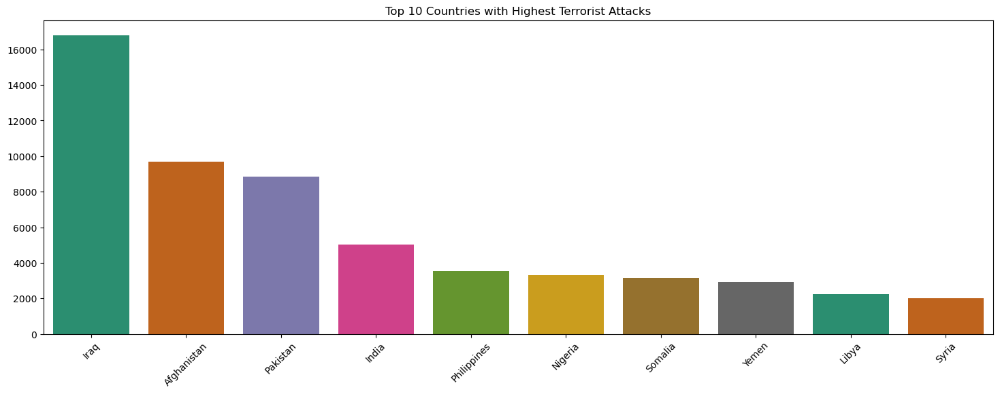

In [34]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2['Country'].value_counts()[:10].index, y=df2['Country'].value_counts()[:10].values, palette='Dark2')
plt.title('Top 10 Countries with Highest Terrorist Attacks')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:-</span>

1- Iraq was the most affected countries with Terrorism with 16799 attacks in between 2011-2017. 
And Iraq was the only country which faced more than 10,000+ attacks between 2011 and 2017.

2- Iraq(with 16799 attacks) , Afghanistan( with 9695 attacks)  and Pakistan( with 8846 attacks) were the only countries which faced more than 8000+ terrorist attacks between 2011 and 2017.

3- We can conclusively say that the no of terrorist attacks reduced in India after 2011 in comparison to no of attacks between 1970-2017.
    

## <span style="color: teal;">Which region faced the highest number of terrorist attacks after 2011?</span>

In [35]:
df2.Region.value_counts()[:10]

Middle East & North Africa    29839
South Asia                    25067
Sub-Saharan Africa            10499
Southeast Asia                 6026
Eastern Europe                 2228
Western Europe                 1566
South America                  1105
North America                   342
East Asia                       105
Central Asia                     62
Name: Region, dtype: int64

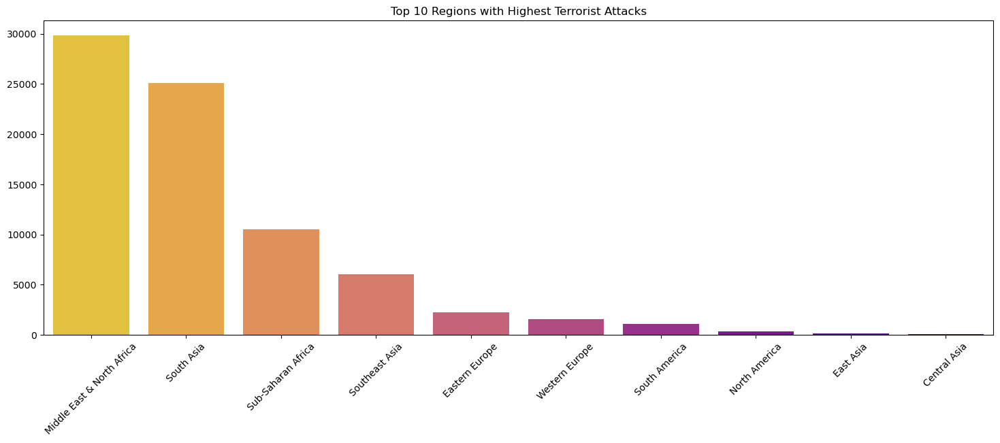

In [36]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2['Region'].value_counts()[:10].index, y=df2['Region'].value_counts()[:10].values, palette='plasma_r')
plt.title('Top 10 Regions with Highest Terrorist Attacks')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:-</span>
    

1) Middle East & North Africa Region and South Asian Region were the only 2 regions which faced more than 25,000+ attacks in between 2011 and 2017.



2) Apart from Middle East & North Africa Region and South Asian Region, Sub- Saharan Africa region is the only region which faced more than 10,000+ attacks in between 2011 and 2017.

## <span style="color: teal;">Which are the most common types of Terrorist attacks?</span>

In [37]:
df2.AttackType.value_counts()

Bombing/Explosion                      40361
Armed Assault                          17584
Hostage Taking (Kidnapping)             5591
Assassination                           4798
Unknown                                 3860
Facility/Infrastructure Attack          3804
Unarmed Assault                          390
Hostage Taking (Barricade Incident)      315
Hijacking                                210
Name: AttackType, dtype: int64

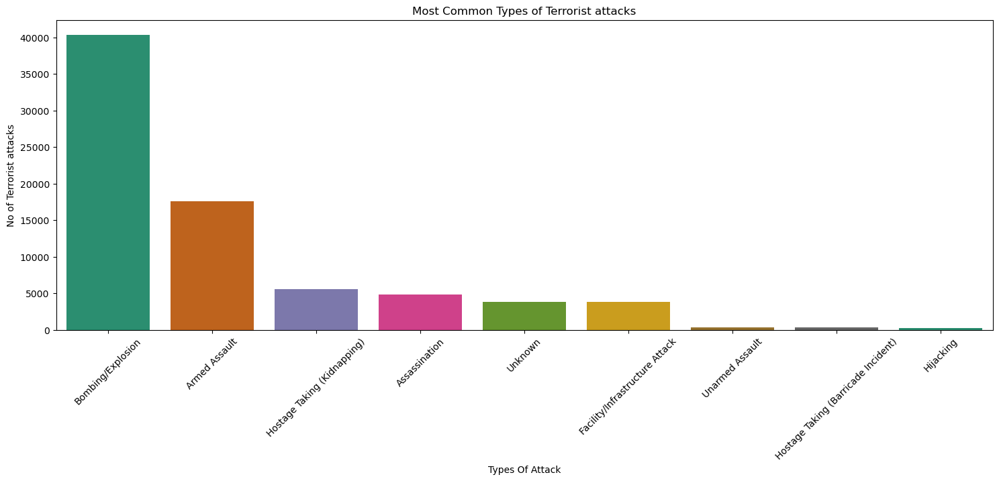

In [38]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2['AttackType'].value_counts().index, y=df2['AttackType'].value_counts().values, palette='Dark2')
plt.title('Most Common Types of Terrorist attacks')
plt.xticks(rotation=45)
plt.xlabel('Types Of Attack')
plt.ylabel('No of Terrorist attacks')
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Most of the terrorist groups preffered to carry out Bombing/Explosion to spread Terrorism



2) After Bombing/Explosion, terrorist groups use Armed Assault, Kidnapping and Assaniation to spread Terrorism after 2011.

## <span style="color: teal;">Who were the targets of terrorist groups after 2011?</span>

In [39]:
df2.Target_type.value_counts()

Private Citizens & Property       20028
Military                          15784
Police                            12042
Government (General)               6852
Business                           5408
Unknown                            4711
Religious Figures/Institutions     2028
Educational Institution            1678
Terrorists/Non-State Militia       1649
Transportation                     1542
Utilities                          1504
Journalists & Media                 963
Violent Political Party             906
Government (Diplomatic)             705
NGO                                 339
Telecommunication                   277
Airports & Aircraft                 177
Food or Water Supply                 84
Other                                78
Maritime                             78
Tourists                             67
Abortion Related                     13
Name: Target_type, dtype: int64

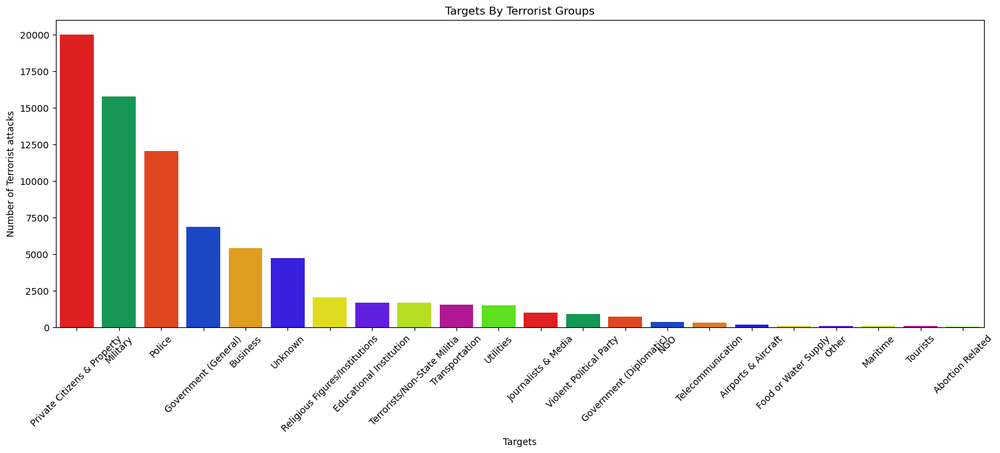

In [40]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2['Target_type'].value_counts().index, y=df2['Target_type'].value_counts().values, palette='prism_r')
plt.title('Targets By Terrorist Groups')
plt.xticks(rotation=45)
plt.xlabel('Targets')
plt.ylabel('Number of Terrorist attacks')
plt.show()

## <span style="color: maroon;">  Observations:-</span>

Terrorist Groups targetted mostly  Private Citizens & Property ,Military , Police after 2011.

## <span style="color: teal;">Which  weapons were most frequently used by terrorists after 2011?</span>

In [41]:
df2.Weapon_type.value_counts()[:10]


Explosives                                                                     43647
Firearms                                                                       21773
Unknown                                                                         6391
Incendiary                                                                      3397
Melee                                                                           1397
Chemical                                                                         126
Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)       86
Other                                                                             51
Sabotage Equipment                                                                39
Biological                                                                         3
Name: Weapon_type, dtype: int64

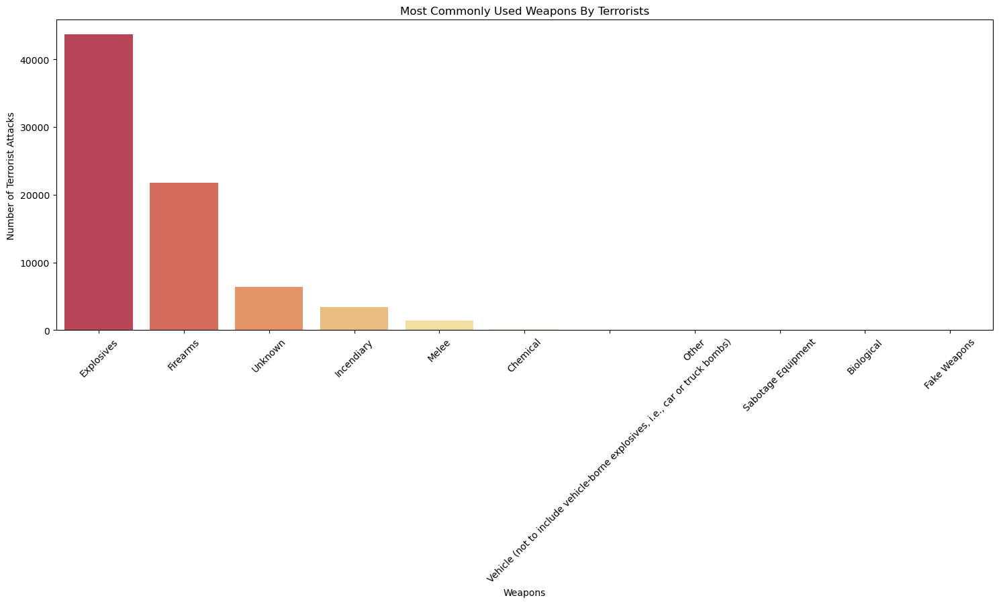

In [42]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2['Weapon_type'].value_counts().index, y=df2['Weapon_type'].value_counts().values, palette='Spectral')
plt.title('Most Commonly Used Weapons By Terrorists')
plt.xticks(rotation=45)
plt.xlabel('Weapons')
plt.ylabel('Number of Terrorist Attacks')
plt.show()

## <span style="color: maroon;"> Observations:-</span>

The figure shows that Explosives ,Firearms are most commonly used weapons used by terrorists for carrying out terrorist attack after 2011.

# <span style="color: olive;">Analyzing Middle East & North Africa region .</span>

In [43]:
df3 = df[df.Year < 2011]
df3.head(2)

,Year,Month,Day,Country,Region,city,latitude,longitude,AttackType,Killed,Wounded,Target,Summary,Group,Target_type,Weapon_type,Motive,Casualty
0,1970,7,2,Dominican Republic,Central America & Caribbean,Santo Domingo,18.456792,-69.951164,Assassination,1.0,0.0,Julio Guzman,NaN,MANO-D,Private Citizens & Property,Unknown,NaN,1.0
1,1970,0,0,Mexico,North America,Mexico city,19.371887,-99.086624,Hostage Taking (Kidnapping),0.0,0.0,"Nadine Chaval, daughter",NaN,23rd of September Communist League,Government (Diplomatic),Unknown,NaN,0.0


##  <span style="color: teal;">Which Countries In Middle East & North Africa region had faced most terrorist attacks ?</span>

## <span style="color: brown"> Before 2011 </span>

In [44]:
df3_region= df3[df3.Region == 'Middle East & North Africa']
df3_region.Country.value_counts()[:10]

Iraq                        6529
Turkey                      2772
Algeria                     2613
Lebanon                     2020
Israel                      1597
West Bank and Gaza Strip    1501
Iran                         616
Egypt                        490
Yemen                        314
Syria                        149
Name: Country, dtype: int64

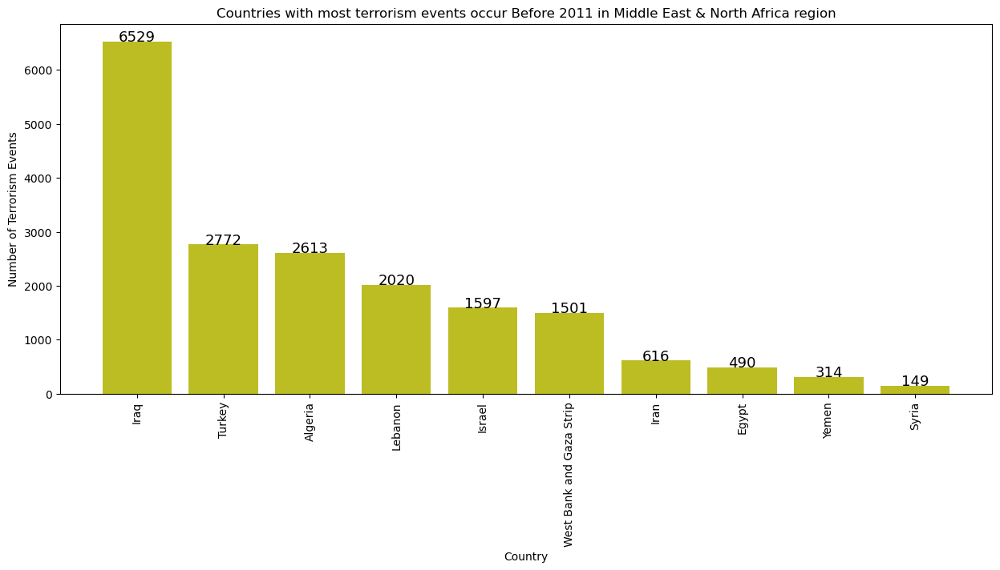

In [45]:
plt.figure(figsize=(15,6))
top_countries = df3_region.Country.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='#bcbd22')

# set the axis labels and title
plt.xlabel('Country')
plt.ylabel('Number of Terrorism Events')
plt.title('Countries with most terrorism events occur Before 2011 in Middle East & North Africa region')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

In [46]:
new_row = pd.DataFrame(data={
    'country': ['Iraq', 'Other countries'],
    'value': [df3_region.Country.value_counts()[0], df3_region.Country.value_counts()[1:].sum()]
})

new_row = new_row.set_index('country')
new_row

,value
country,
Iraq,6529
Other countries,12443


<Axes: ylabel='value'>

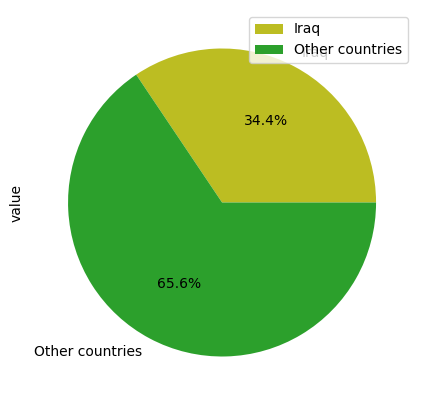

In [47]:
new_row.plot.pie(y='value', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['#bcbd22','#2ca02c'])

## <span style="color: maroon;">Observations:- </span>

1) Iraq alone faced about 34.4% of all the terrorist attacks which happened in the Middle East & North Africa region before  2011.

2) Turkey , Yemen, Algeria , Egypt, Lebanon, Libya, West Bank & Gaza Strip, Syria, Israel  are the only countries after Iraq in Middle East & North Africa region  which faced more than 1500+ terrorist attacks in between 1970-2011.

## <span style="color: brown;">After 2011 </span>

In [48]:
df2_region= df2[df2.Region == 'Middle East & North Africa']
df2_region.Country.value_counts()[:10]

Iraq                        16799
Yemen                        2915
Libya                        2231
Syria                        2003
Egypt                        1971
Turkey                       1469
West Bank and Gaza Strip      706
Israel                        535
Lebanon                       448
Saudi Arabia                  307
Name: Country, dtype: int64

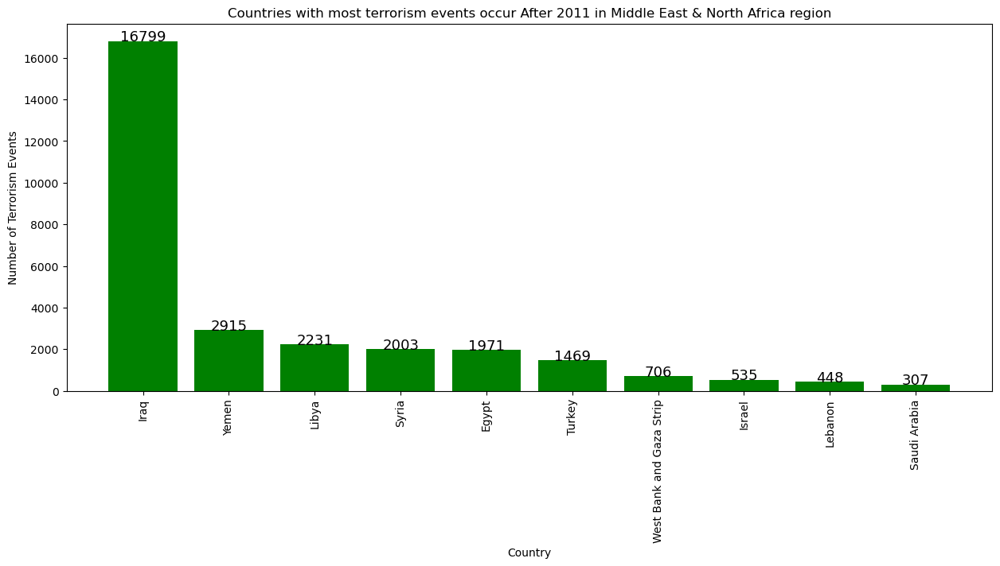

In [49]:
plt.figure(figsize=(15,6))
top_countries = df2_region.Country.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='green')

# set the axis labels and title
plt.xlabel('Country')
plt.ylabel('Number of Terrorism Events')
plt.title('Countries with most terrorism events occur After 2011 in Middle East & North Africa region')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

In [50]:
new_rows = pd.DataFrame(data={
    'country': ['Iraq', 'Other countries'],
    'values': [df2_region.Country.value_counts()[0], df2_region.Country.value_counts()[1:].sum()]
})

new_rows = new_rows.set_index('country')
new_rows

,values
country,
Iraq,16799
Other countries,13040


<Axes: ylabel='values'>

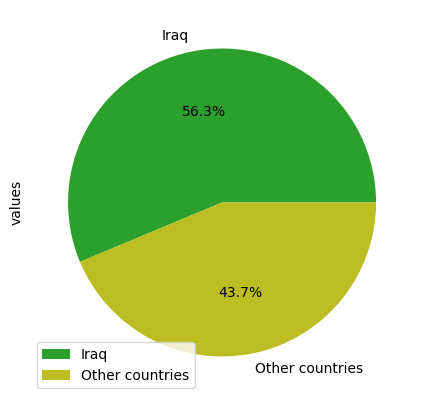

In [51]:
new_rows.plot.pie(y='values', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['#2ca02c','#bcbd22'])

## <span style="color: maroon;">Observations:- </span>

1) Iraq alone faced about 56.3% of all the terrorist attacks which happened in the Middle East & North Africa region in between  2011-2017.

2) Yemen,  Libya,  Syria, Turkey, Egypt are the only countries after Iraq in Middle East & North Africa region which faced more than 1400+ terrorist attacks in between 2011-2017.

## <span style="color: brown;"> Overall </span>

In [52]:
df_region= df[df.Region == 'Middle East & North Africa']
df_region.Country.value_counts()[:10]

Iraq                        24636
Turkey                       4292
Yemen                        3347
Algeria                      2743
Egypt                        2479
Lebanon                      2478
Libya                        2249
West Bank and Gaza Strip     2227
Syria                        2201
Israel                       2183
Name: Country, dtype: int64

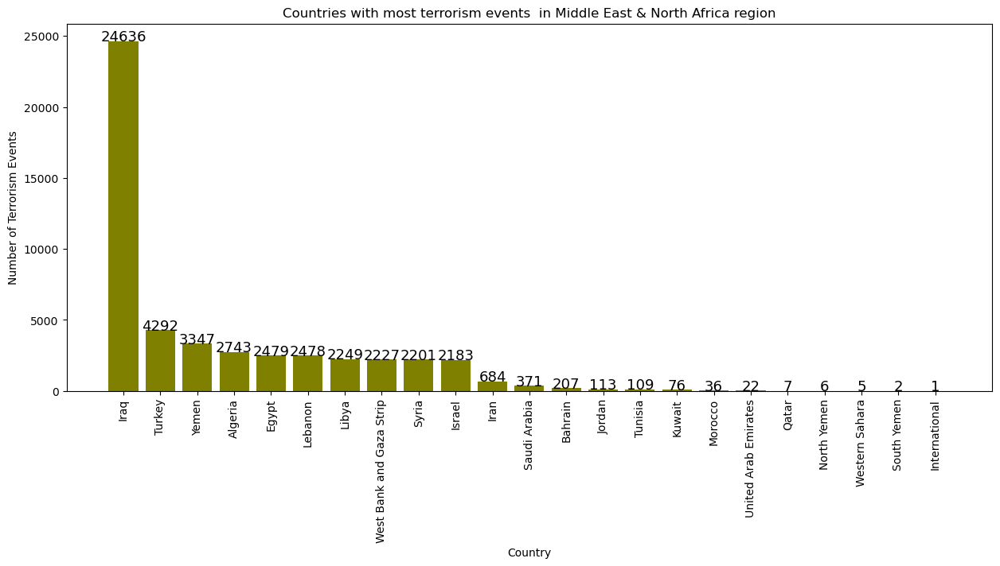

In [53]:
plt.figure(figsize=(15,6))
top_countries = df_region.Country.value_counts()

plt.bar(top_countries.index, top_countries.values, color='olive')

# set the axis labels and title
plt.xlabel('Country')
plt.ylabel('Number of Terrorism Events')
plt.title('Countries with most terrorism events  in Middle East & North Africa region')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

In [54]:
new_rows = pd.DataFrame(data={
    'country': ['Iraq', 'Other countries'],
    'values': [df_region.Country.value_counts()[0], df_region.Country.value_counts()[1:].sum()]
})

new_rows1 = new_rows.set_index('country')
new_rows1

,values
country,
Iraq,24636
Other countries,25838


<Axes: ylabel='values'>

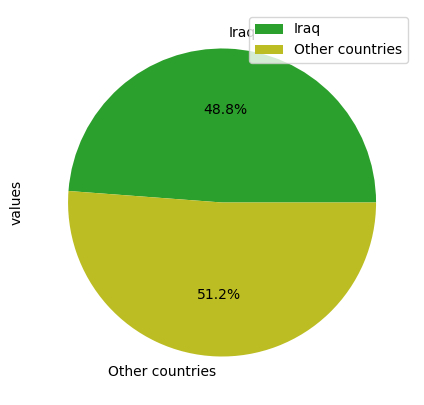

In [55]:
new_rows1.plot.pie(y='values', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['#2ca02c','#bcbd22'])

## <span style="color: maroon;">Observations:- </span>







1) Overall Iraq alone faced 48.8%  of the terrorist attacks which were carried out by terrorist groups in the  Middle East & North Africa region.

2)  After 2011, Iraq faced 56 % of the terrorist attacks which were happened in the Middle East & North Africa region which means Iraq was more targetted by the terrorist groups in the period of 2011- 2017 as compared to the period of 1970-2011 where Iraq faced 34% of the terrorist atatcks inwhich were happened in the Middle East & North Africa region.

3) In the Middle East & North Africa region, After Iraq, Turkey , Yemen, Algeria , Egypt, Lebanon, Libya, West Bank & Gaza Strip, Syria, Israel are the countries which faced more than 2000+ terrorist attacks

4) In this region, South Yemen, Western Sahara, North Yemen, Qatar, UAE, Morroco, Kuwait are the only countries which faced less than 100 terrorist attacks.

## <span style="color: teal;"> What methods were used by Terrorist Groups to spread terrorism in Middle East & North Africa Region?</span>

## <span style="color: brown;">  Before 2011 </span>

In [56]:
df3_region= df3[df3.Region == 'Middle East & North Africa']
df3_region.AttackType.value_counts()[:10]

Bombing/Explosion                      10243
Armed Assault                           4179
Assassination                           2669
Hostage Taking (Kidnapping)              776
Facility/Infrastructure Attack           499
Unknown                                  400
Unarmed Assault                           88
Hijacking                                 80
Hostage Taking (Barricade Incident)       38
Name: AttackType, dtype: int64

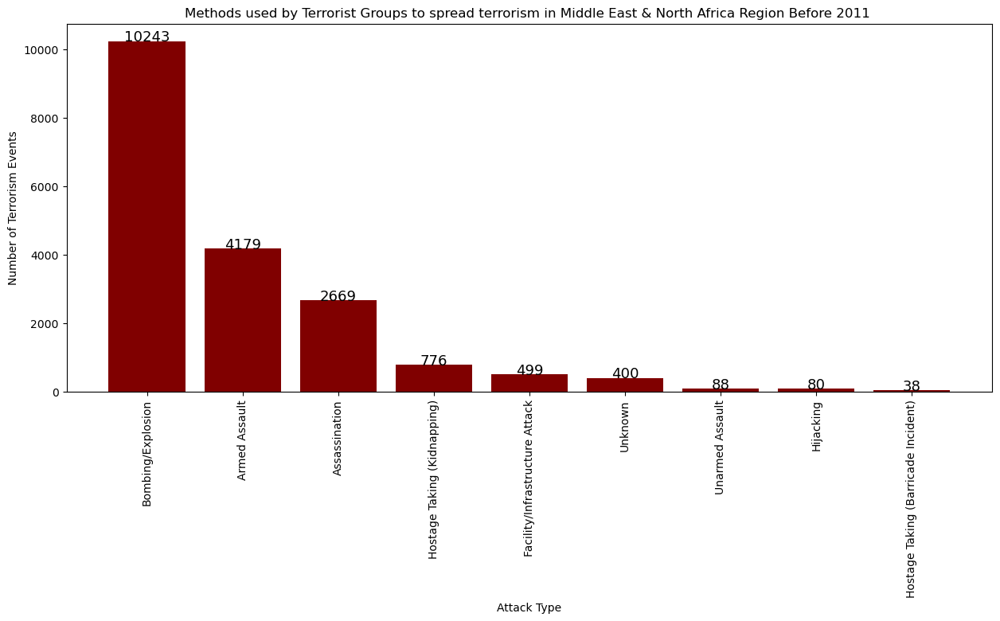

In [57]:
plt.figure(figsize=(15,6))
top_countries = df3_region.AttackType.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='maroon')

# set the axis labels and title
plt.xlabel('Attack Type')
plt.ylabel('Number of Terrorism Events')
plt.title('Methods used by Terrorist Groups to spread terrorism in Middle East & North Africa Region Before 2011 ')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

## <span style="color: maroon;">Observations:- </span>

Bombing/Explosion, Armed Assault , Assassination were the methods preffered by Terrorist Groups to spread terrorism in Middle East & North Africa in between 1970-2011.

## <span style="color: brown;">  After 2011 </span>

In [58]:
df2_region= df2[df2.Region == 'Middle East & North Africa']
df2_region.AttackType.value_counts()[:10]

Bombing/Explosion                      19679
Armed Assault                           4706
Hostage Taking (Kidnapping)             1834
Unknown                                 1471
Assassination                           1362
Facility/Infrastructure Attack           583
Unarmed Assault                           86
Hostage Taking (Barricade Incident)       61
Hijacking                                 57
Name: AttackType, dtype: int64

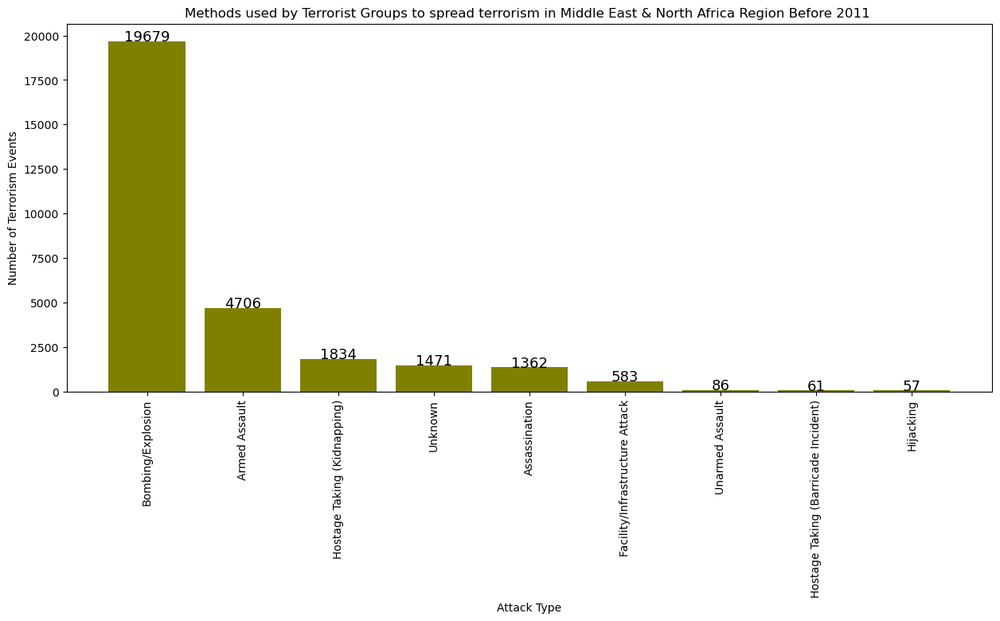

In [59]:
plt.figure(figsize=(15,6))
top_countries = df2_region.AttackType.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='olive')

# set the axis labels and title
plt.xlabel('Attack Type')
plt.ylabel('Number of Terrorism Events')
plt.title('Methods used by Terrorist Groups to spread terrorism in Middle East & North Africa Region Before 2011 ')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

## <span style="color: maroon;">Observations:- </span>

Bombing/Explosion,   Armed Assault , Hostage Taking(Kidnapping) were the methods preffered by Terrorist Groups to spread terrorism in Middle East & North Africa in between 2011-2017.

## <span style="color: brown;">Overall </span>

In [60]:
df_region= df[df.Region == 'Middle East & North Africa']
df_region.AttackType.value_counts()[:10]

Bombing/Explosion                      30908
Armed Assault                           9273
Assassination                           4206
Hostage Taking (Kidnapping)             2666
Unknown                                 1891
Facility/Infrastructure Attack          1115
Unarmed Assault                          177
Hijacking                                138
Hostage Taking (Barricade Incident)      100
Name: AttackType, dtype: int64

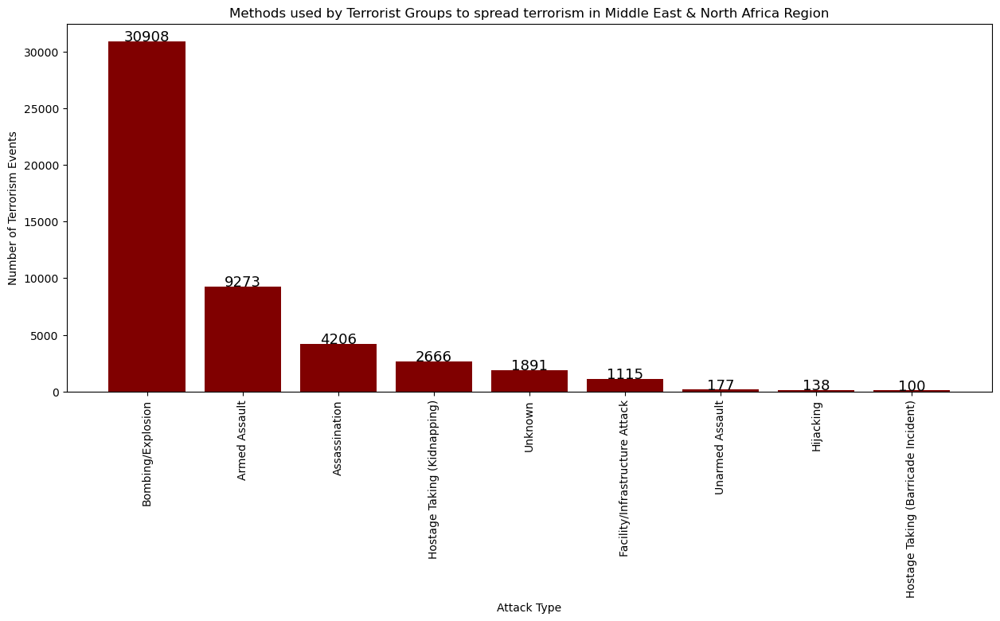

In [61]:
plt.figure(figsize=(15,6))
top_countries = df_region.AttackType.value_counts()

plt.bar(top_countries.index, top_countries.values, color='maroon')

# set the axis labels and title
plt.xlabel('Attack Type')
plt.ylabel('Number of Terrorism Events')
plt.title('Methods used by Terrorist Groups to spread terrorism in Middle East & North Africa Region')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

In [62]:
new_row = pd.DataFrame(data={
    'Attack_Type': ['Bombing/Explosion', 'Other Methods'],
    'value': [df_region.AttackType.value_counts()[0],df_region.AttackType.value_counts() [1:].sum()]
})

new_row5 = new_row.set_index('Attack_Type')
new_row5



,value
Attack_Type,
Bombing/Explosion,30908
Other Methods,19566


<Axes: ylabel='value'>

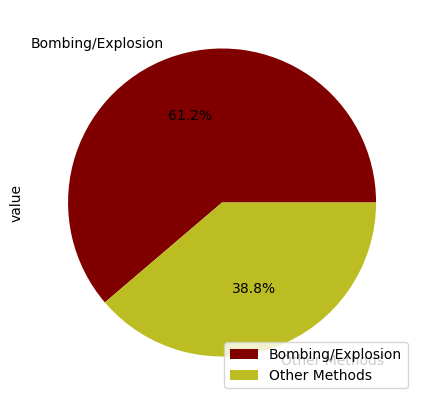

In [63]:
new_row5.plot.pie(y='value', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['maroon','#bcbd22'])

In [64]:
armed_assault_count = (df_region['AttackType'] == 'Armed Assault').sum()
other_methods_count = (df_region['AttackType'] != 'Armed Assault').sum()

new_row = pd.DataFrame(data={
    'Attack_Type': ['Armed Assault', 'Other Methods'],
    'value': [armed_assault_count, other_methods_count]
})

new_row6 = new_row.set_index('Attack_Type')
print(new_row6)

               value
Attack_Type         
Armed Assault   9273
Other Methods  41201


<Axes: ylabel='value'>

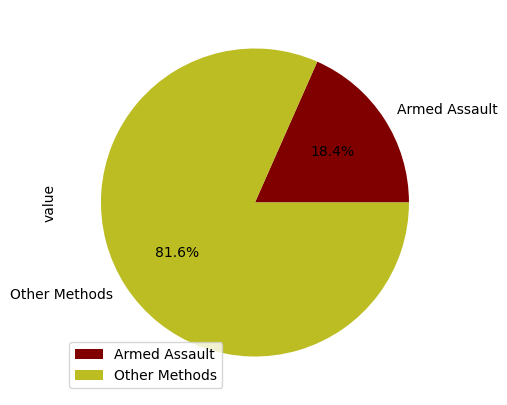

In [65]:
new_row6.plot.pie(y='value', figsize=(5, 5), legend = 'Attack_Type', autopct='%1.1f%%', colors=['maroon','#bcbd22'])

## <span style="color: maroon;"> Observations- </span>





1) The above graph shows that in 61.2% cases terrorists used Bombing/ Explosions to spread terrorism in Middle East & North Africa Region.

2) In 18.4% cases terrorists preffered Armed Assault and in 8.3 % cases terrosrist preffered Assaniation to spread terrorism in Middle East & North Africa Region.

## <span style="color: teal">Who were mostly targeted by Terrorist Groups in Middle East & North Africa region?</span>

In [66]:
df3_region= df3[df3.Region == 'Middle East & North Africa']
df3_region.Target_type.value_counts()[:10]

Private Citizens & Property       5566
Military                          2604
Police                            2495
Government (General)              2092
Business                          1957
Transportation                     764
Government (Diplomatic)            606
Religious Figures/Institutions     549
Terrorists/Non-State Militia       483
Educational Institution            388
Name: Target_type, dtype: int64

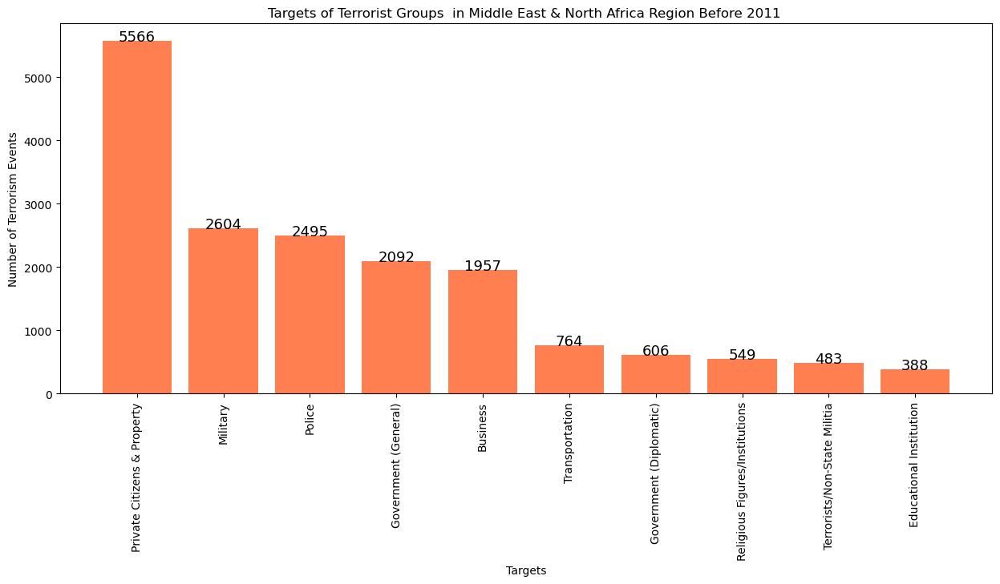

In [67]:
plt.figure(figsize=(15,6))
top_countries = df3_region.Target_type.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='coral')

# set the axis labels and title
plt.xlabel('Targets')
plt.ylabel('Number of Terrorism Events')
plt.title('Targets of Terrorist Groups  in Middle East & North Africa Region Before 2011 ')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

## <span style="color: BROWN;"> After 2011</span>

In [68]:
df2_region= df2[df2.Region == 'Middle East & North Africa']
df2_region.Target_type.value_counts()[:10]

Private Citizens & Property       9187
Military                          6517
Police                            4111
Business                          2074
Unknown                           1951
Government (General)              1838
Terrorists/Non-State Militia      1139
Religious Figures/Institutions     671
Utilities                          550
Educational Institution            404
Name: Target_type, dtype: int64

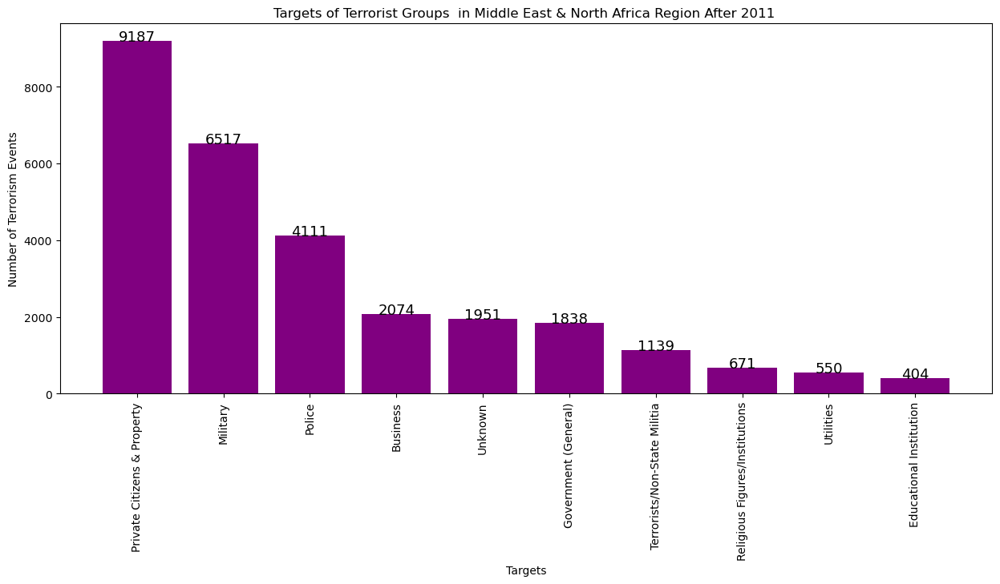

In [69]:
plt.figure(figsize=(15,6))
top_countries = df2_region.Target_type.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='purple')

# set the axis labels and title
plt.xlabel('Targets')
plt.ylabel('Number of Terrorism Events')
plt.title('Targets of Terrorist Groups  in Middle East & North Africa Region After 2011 ')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()


## <span style="color: brown;">  Overall </span>

In [70]:
df_region= df[df.Region == 'Middle East & North Africa']
df_region.Target_type.value_counts()[:10]

Private Citizens & Property       15257
Military                           9269
Police                             6893
Government (General)               4256
Business                           4158
Unknown                            2160
Terrorists/Non-State Militia       1701
Religious Figures/Institutions     1263
Transportation                     1186
Educational Institution             819
Name: Target_type, dtype: int64

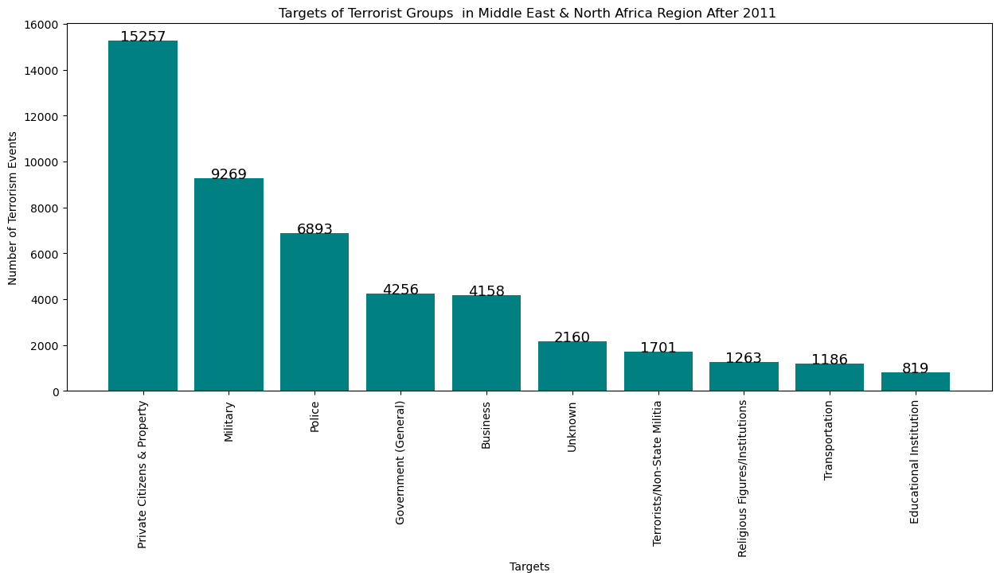

In [71]:
plt.figure(figsize=(15,6))
top_countries = df_region.Target_type.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='teal')

# set the axis labels and title
plt.xlabel('Targets')
plt.ylabel('Number of Terrorism Events')
plt.title('Targets of Terrorist Groups  in Middle East & North Africa Region After 2011 ')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

## <span style="color: maroon;">Observations:-</span>


    



1) Private Citizens & Property were more vulnerable to Terrorist attacks in the Middle East & North Africa Region.

2) After Private Citizens & Property, Military ,Police, Govternment Organisations & Business Organisations were mostly targetted by Terrorists in Middle East & North Africa Region.

### <span style="color: teal"> Whaich  Terrorist Group had  carried out the most terrorist attacks in Middle East & North Africa ?</span>

## <span style="color: brown"> Before 2011 </span>

In [72]:
df3_region= df3[df3.Region == 'Middle East & North Africa']
df3_region.Group.value_counts()[:10]

Unknown                                11004
Palestinians                            1105
Kurdistan Workers' Party (PKK)          1030
Algerian Islamic Extremists              373
Hezbollah                                353
Hamas (Islamic Resistance Movement)      285
Al-Gama'at al-Islamiyya (IG)             257
Dev Sol                                  236
Armed Islamic Group (GIA)                226
Al-Qaida in Iraq                         220
Name: Group, dtype: int64

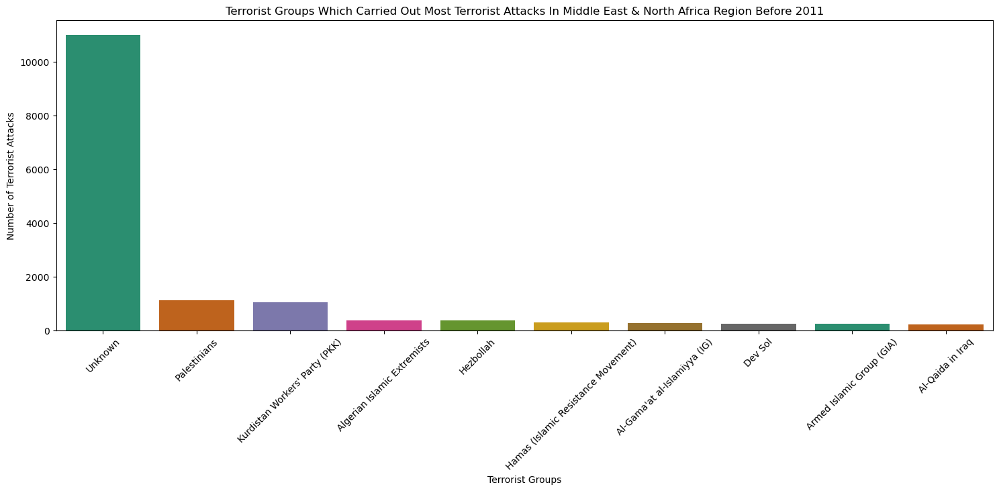

In [73]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region['Group'].value_counts()[:10].index, y=df3_region['Group'].value_counts()[:10].values, palette='Dark2')
plt.title('Terrorist Groups Which Carried Out Most Terrorist Attacks In Middle East & North Africa Region Before 2011')
plt.xticks(rotation=45)
plt.xlabel('Terrorist Groups')
plt.ylabel('Number of Terrorist Attacks')
plt.show()

## <span style="color: brown"> After 2011 </span>

In [74]:
df2_region= df2[df2.Region == 'Middle East & North Africa']
df2_region.Group.value_counts()[:10]

Unknown                                        16967
Islamic State of Iraq and the Levant (ISIL)     5563
Kurdistan Workers' Party (PKK)                  1073
Houthi extremists (Ansar Allah)                 1048
Al-Qaida in the Arabian Peninsula (AQAP)         888
Sinai Province of the Islamic State              445
Palestinian Extremists                           411
Al-Qaida in Iraq                                 386
Muslim extremists                                351
Tripoli Province of the Islamic State            350
Name: Group, dtype: int64

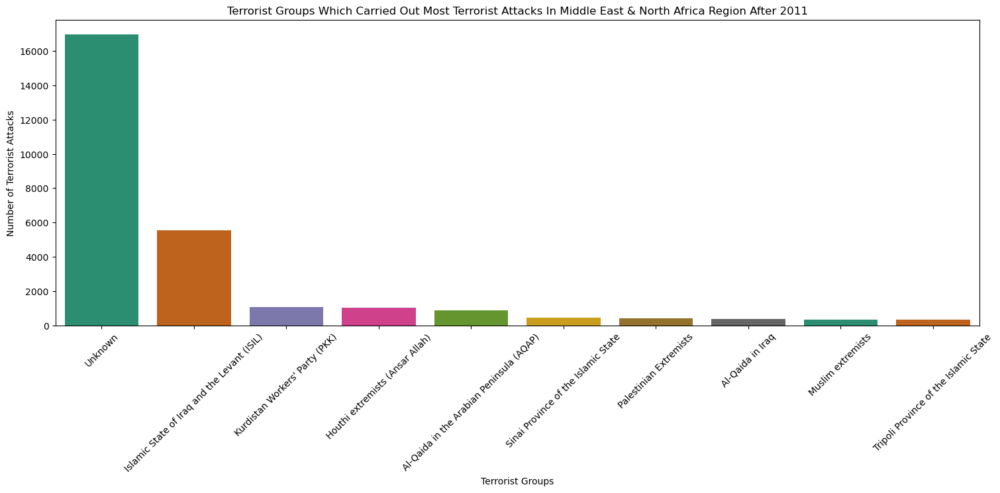

In [75]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region['Group'].value_counts()[:10].index, y=df2_region['Group'].value_counts()[:10].values, palette='Dark2')
plt.title('Terrorist Groups Which Carried Out Most Terrorist Attacks In Middle East & North Africa Region After 2011')
plt.xticks(rotation=45)
plt.xlabel('Terrorist Groups')
plt.ylabel('Number of Terrorist Attacks')
plt.show()

## <span style="color:brown"> Overall </span>

In [76]:
df_region= df[df.Region == 'Middle East & North Africa']
df_region.Group.value_counts()[:10]

Unknown                                        29377
Islamic State of Iraq and the Levant (ISIL)     5563
Kurdistan Workers' Party (PKK)                  2137
Palestinians                                    1105
Houthi extremists (Ansar Allah)                 1062
Al-Qaida in the Arabian Peninsula (AQAP)        1017
Al-Qaida in Iraq                                 637
Sinai Province of the Islamic State              445
Palestinian Extremists                           440
Hamas (Islamic Resistance Movement)              407
Name: Group, dtype: int64

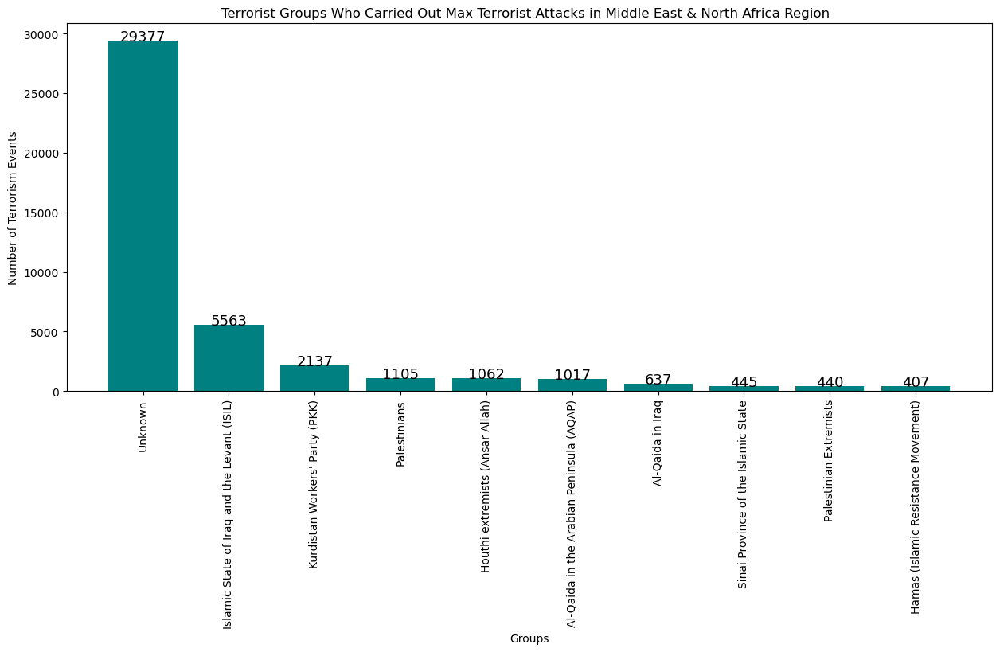

In [77]:
plt.figure(figsize=(15,6))
top_countries = df_region.Group.value_counts()[:10]

plt.bar(top_countries.index, top_countries.values, color='teal')

# set the axis labels and title
plt.xlabel('Groups')
plt.ylabel('Number of Terrorism Events')
plt.title('Terrorist Groups Who Carried Out Max Terrorist Attacks in Middle East & North Africa Region  ')

# rotate the x-axis labels for better visibility
plt.xticks(rotation=90)

for i, v in enumerate(top_countries.values):
    plt.text(top_countries.index[i], v + 0.2, str(round(v, 2)), fontsize=13, color='black', ha='center')

# show the plot
plt.show()

In [78]:
new_row = pd.DataFrame(data={
    'Group': ['Unknown Groups', 'Known Groups'],
    'value': [df_region.Group.value_counts()[0],df_region.Group.value_counts() [1:].sum()]
})

new_row9 = new_row.set_index('Group')
new_row9


,value
Group,
Unknown Groups,29377
Known Groups,21097


<Axes: ylabel='value'>

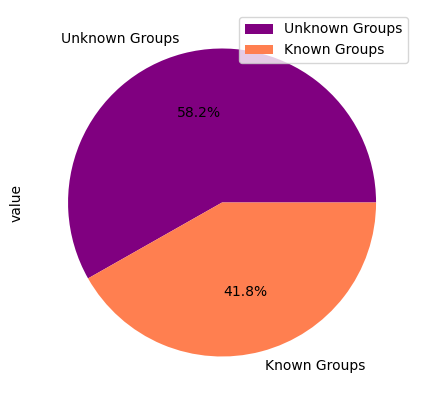

In [79]:
new_row9.plot.pie(y='value', figsize=(5, 5), legend = 'Group', autopct='%1.1f%%', colors=[  'purple', 'coral'])

##  <span style="color: maroon;"> Observations- </span>

1) Unknown Groups with 29377 attacks had carried out most attacks in the Middle East & North Africa Region in between 1970-2017. 

2) From known Terrorist Groups, Islamic State of Iraq and the Levant (ISIL) with  5563 attacks and Kurdistan Workers' Party (PKK) with 2137 atatcks have carried out the 2nd most and 3rd most terrorist attacks in the Middle East & North Africa Region.

# <span style="color: olive;">Analysis Of South Asia region </span>

##  <span style="color: teal;">Which Countries In South Asia region had faced most terrorist attacks ?</span>

## <span style="color: brown"> Before 2011 </span>

In [81]:
df3_region= df3[df3.Region == 'South Asia']
df3_region.Country.value_counts()[:20]

India          6275
Pakistan       4510
Sri Lanka      2935
Afghanistan    2615
Bangladesh      750
Nepal           674
Maldives          4
Bhutan            4
Mauritius         2
Name: Country, dtype: int64

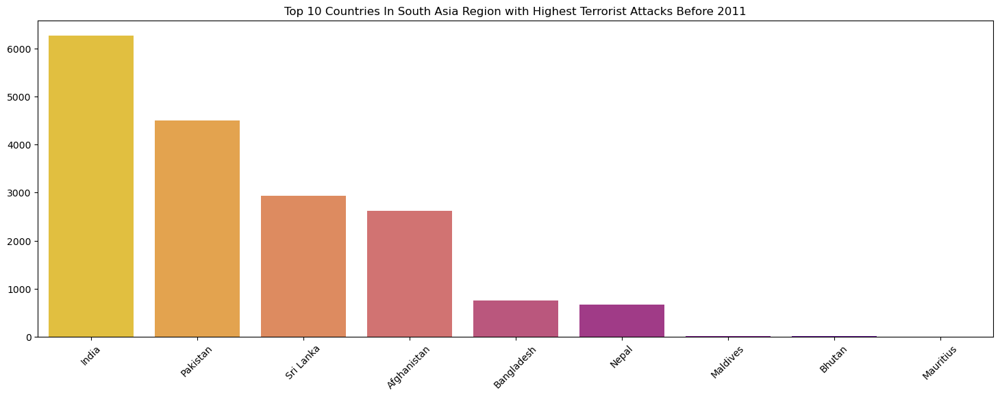

In [82]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.Country.value_counts()[:20].index, y=df3_region.Country.value_counts()[:20].values, palette='plasma_r')
plt.title('Top 10 Countries In South Asia Region with Highest Terrorist Attacks Before 2011')
plt.xticks(rotation=45)
plt.show()

##  <span style="color: maroon"> Observations:-</span>



1) Before 2011, India (with 6275 terrorist attacks) tops the chart of top 10 countries with Highest Terrorist Attacks in South Asia region followed by Pakistan( with 6275 attacks), Sri Lanka() with 2935 attacks) and Afghanistan(with 2615 attacks). 







2) Maldives, Bhutan, Maurutius are the only countries in South Asia which faced than less than 10 terrorist atatck in between 1970-2011.

## <span style="color: brown;">After 2011 </span>

In [83]:
df2_region= df2[df2.Region == 'South Asia']
df2_region.Country.value_counts()[:10]

Afghanistan    9695
Pakistan       8846
India          5040
Bangladesh      885
Nepal           495
Sri Lanka        87
Maldives         18
Bhutan            1
Name: Country, dtype: int64

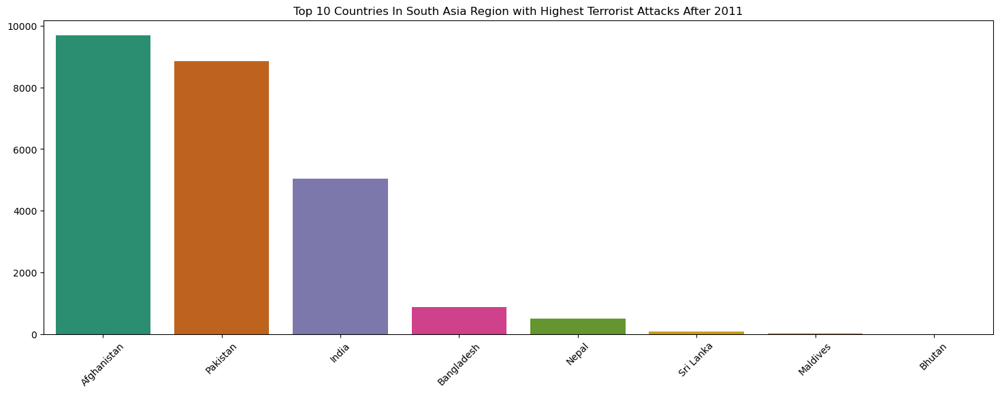

In [84]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.Country.value_counts()[:10].index, y=df2_region.Country.value_counts()[:10].values, palette='Dark2')
plt.title('Top 10 Countries In South Asia Region with Highest Terrorist Attacks After 2011')
plt.xticks(rotation=45)
plt.show()

##  <span style="color: maroon"> Observations:-</span> 

1)  After 2011, the tables has been turned. Afgnaistan( with 9695 attacks) topped the list of tops the chart of top 10 countries with Highest Terrorist Attacks in South Asia region followed by Pakistan in 2nd ( with 8846 attacks ) and India In 3rd (with 5040 attacks).



2) Although, India had 3rd highest no of attacks between between 2011-2017 among the Asian Countries, but fortunately the no of terrorist attacks decreased after 2011. Along with India, the no of terrorist attacks also significantly decreased for Nepal and Sri Lankka  as well.

3) But there was sightly increase in  no of terrorist attacks in Bangladesh.

## <span style="color: brown;">Overall </span>

In [85]:
df_region= df[df.Region == 'South Asia']
df_region.Country.value_counts()[:10]

Pakistan       14368
Afghanistan    12731
India          11960
Sri Lanka       3022
Bangladesh      1648
Nepal           1215
Maldives          22
Bhutan             6
Mauritius          2
Name: Country, dtype: int64

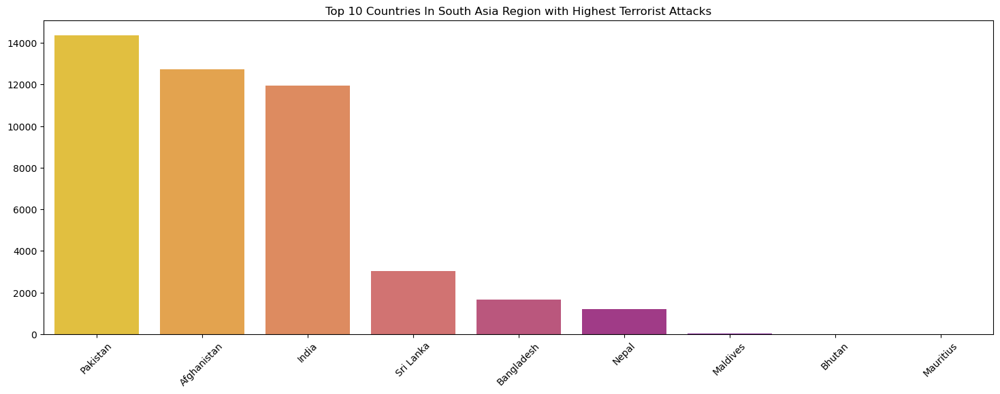

In [86]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.Country.value_counts()[:20].index, y=df_region.Country.value_counts()[:20].values, palette='plasma_r')
plt.title('Top 10 Countries In South Asia Region with Highest Terrorist Attacks')
plt.xticks(rotation=45)
plt.show()

##  <span style="color: maroon"> Observations:-</span> 

1) We can clearly see that Pakistan, Afghanistan and India are the only countries in the South Asia region which faced more than 10,000+ terrorist attacks from 1970-2017 and we can assume that they are more vulnerable to terrorist attacks than any other countries in this region

2) We can assume countries like Maldives, Bhutan, Mauritus to be less vulnerable to terrorist attacks since these countries hadn't faced more than 25 terrorist attacks during 1970-2017.

## <span style="color: teal;"> Whach methods were used by Terrorist Groups to spread terrorism in South Asia Region?</span>

## <span style="color: brown;">  Before 2011 </span>

In [87]:
df3_region= df3[df3.Region == 'South Asia']
df3_region.AttackType.value_counts()[:10]

Bombing/Explosion                      7584
Armed Assault                          4872
Assassination                          2412
Hostage Taking (Kidnapping)            1211
Facility/Infrastructure Attack          786
Unknown                                 662
Unarmed Assault                         150
Hijacking                                67
Hostage Taking (Barricade Incident)      25
Name: AttackType, dtype: int64

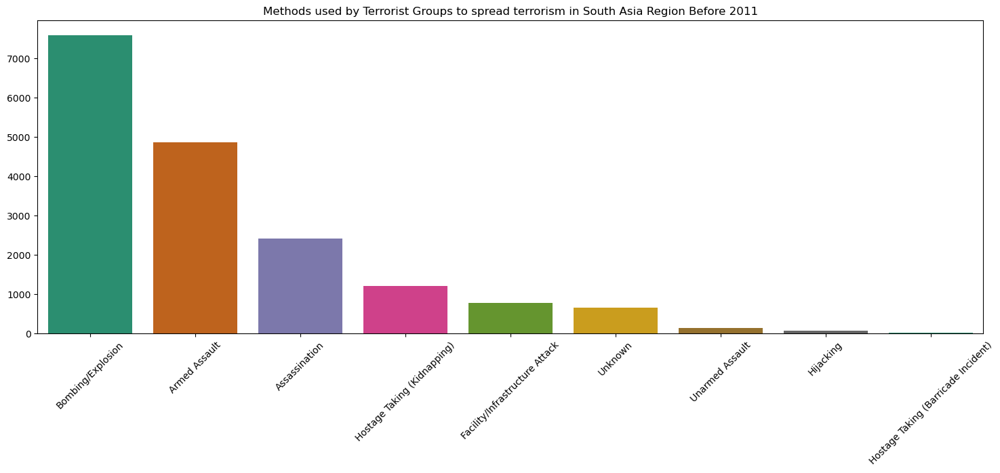

In [88]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.AttackType.value_counts()[:10].index, y=df3_region.AttackType.value_counts()[:10].values, palette='Dark2')
plt.title('Methods used by Terrorist Groups to spread terrorism in South Asia Region Before 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

Bombing/Explosion, Armed Assault , Assassination were the methods preffered by Terrorist Groups to spread terrorism in South Asia in between 1970-2011.

## <span style="color: brown;">  After 2011 </span>

In [89]:
df2_region= df2[df2.Region == 'South Asia']
df2_region.AttackType.value_counts()[:10]

Bombing/Explosion                      12634
Armed Assault                           5942
Hostage Taking (Kidnapping)             1854
Assassination                           1780
Unknown                                 1297
Facility/Infrastructure Attack          1281
Unarmed Assault                          161
Hostage Taking (Barricade Incident)       94
Hijacking                                 24
Name: AttackType, dtype: int64

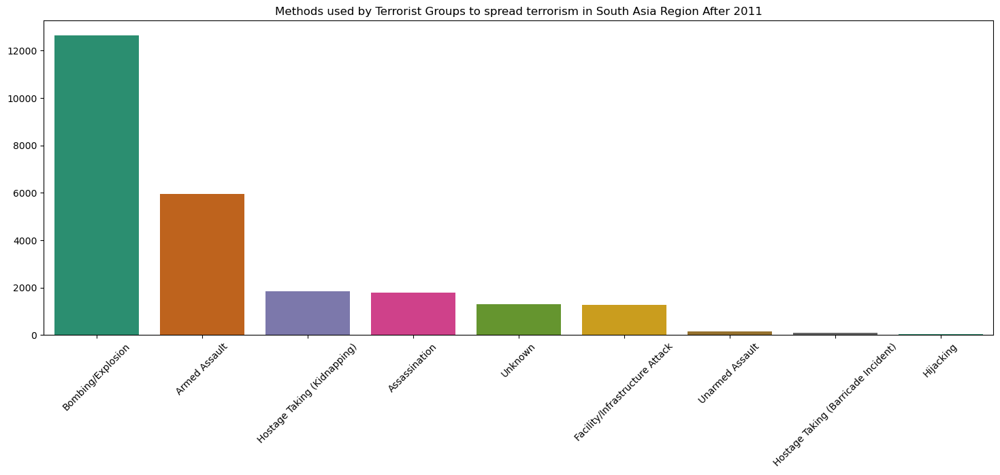

In [90]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.AttackType.value_counts()[:10].index, y=df2_region.AttackType.value_counts()[:10].values, palette='Dark2')
plt.title('Methods used by Terrorist Groups to spread terrorism in South Asia Region After 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Bombing/Explosion, Armed Assault ,Kidnappings, Assassination were the methods preffered by Terrorist Groups to spread terrorism in South Asia in between 2011-2017.

2) We can see there is a slight increase in the number of Kidnappings by Terrorists after 2011 .

## <span style="color: maroon;">Overall </span>

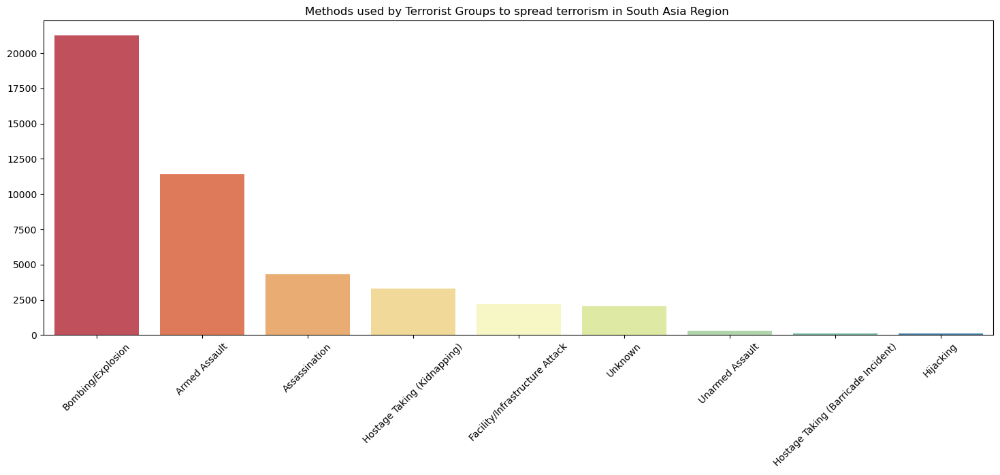

In [91]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.AttackType.value_counts()[:10].index, y=df_region.AttackType.value_counts()[:10].values, palette='Spectral')
plt.title('Methods used by Terrorist Groups to spread terrorism in South Asia Region ')
plt.xticks(rotation=45)
plt.show()

In [92]:
new_row = pd.DataFrame(data={
    'Attack_Type': ['Bombing/Explosion', 'Other Methods'],
    'value': [df_region.AttackType.value_counts()[0],df_region.AttackType.value_counts() [1:].sum()]
})

new_rows9 = new_row.set_index('Attack_Type')
new_rows9
new_rows9.plot.pie(y='value', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['teal','coral'])

,value
Attack_Type,
Bombing/Explosion,21246
Other Methods,23728


<Axes: ylabel='value'>

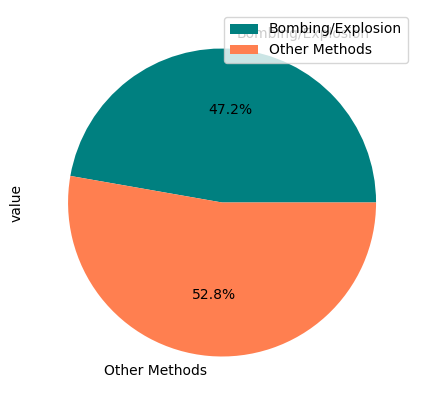

In [93]:
new_rows9.plot.pie(y='value', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['teal','coral'])

In [94]:
armed_assault_count = (df_region['AttackType'] == 'Armed Assault').sum()
other_methods_count = (df_region['AttackType'] != 'Armed Assault').sum()

new_row = pd.DataFrame(data={
    'Attack_Type': ['Armed Assault', 'Other Methods'],
    'value': [armed_assault_count, other_methods_count]
})

new_row11 = new_row.set_index('Attack_Type')
print(new_row11)


               value
Attack_Type         
Armed Assault  11404
Other Methods  33570


<Axes: ylabel='value'>

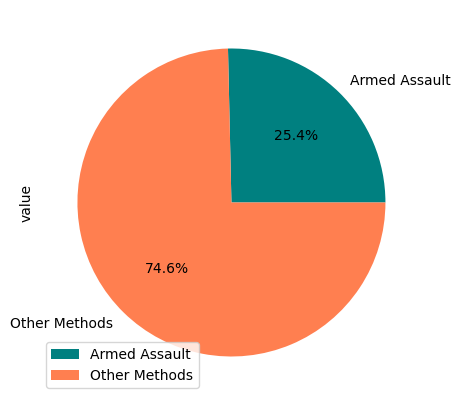

In [95]:
new_row11.plot.pie(y='value', figsize=(5, 5), legend = 'country', autopct='%1.1f%%', colors=['teal','coral'])

## <span style="color: maroon;">Observations:- </span>

Out of all the terrorist atatcks in South Asia region,In 72.6% cases Terrorists preffered Bombing/ Explosion and Armed Assault to carry out terrorist attack in South Asia Region.

## <span style="color: teal">Who were mostly targeted by Terrorist Groups in Middle East & North Africa region?</span>

## <span style="color: brown;">  Before 2011 </span>

In [96]:
df3_region= df3[df3.Region == 'South Asia']
df3_region.Target_type.value_counts()[:10]

Private Citizens & Property       4914
Government (General)              2623
Police                            2558
Military                          1581
Business                          1365
Transportation                    1284
Educational Institution            728
Religious Figures/Institutions     497
Violent Political Party            448
Unknown                            352
Name: Target_type, dtype: int64

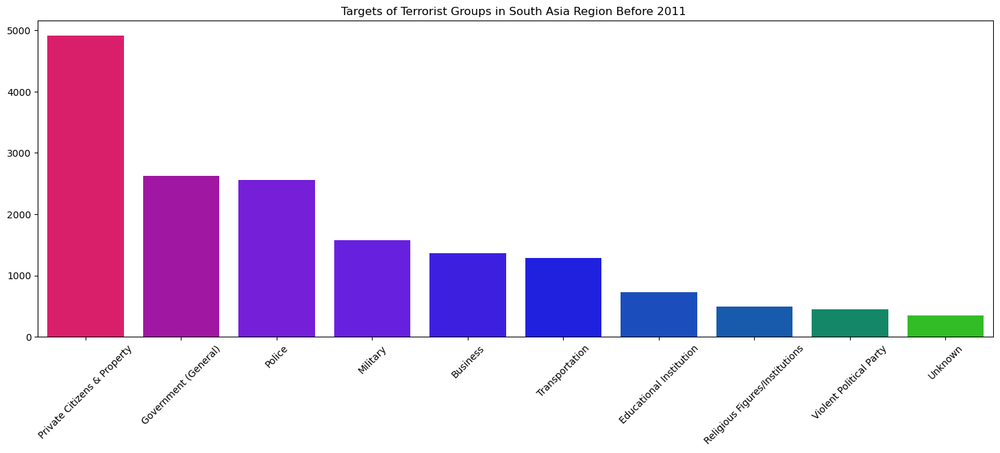

In [97]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.Target_type.value_counts()[:10].index, y=df3_region.Target_type.value_counts()[:10].values, palette='prism')
plt.title('Targets of Terrorist Groups in South Asia Region Before 2011 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

Private Citizens & Property, Government, Police, Millitary, Business, Transportations were mostly targeted by by the Terrorist Groups in South Asia Region before 2011.

## <span style="color: brown;">  After 2011 </span>

In [98]:
df2_region= df2[df2.Region == 'South Asia']
df2_region.Target_type.value_counts()[:10]

Police                            5653
Private Citizens & Property       5006
Military                          3994
Government (General)              2486
Unknown                           2014
Business                          1568
Educational Institution            888
Transportation                     690
Violent Political Party            634
Religious Figures/Institutions     607
Name: Target_type, dtype: int64

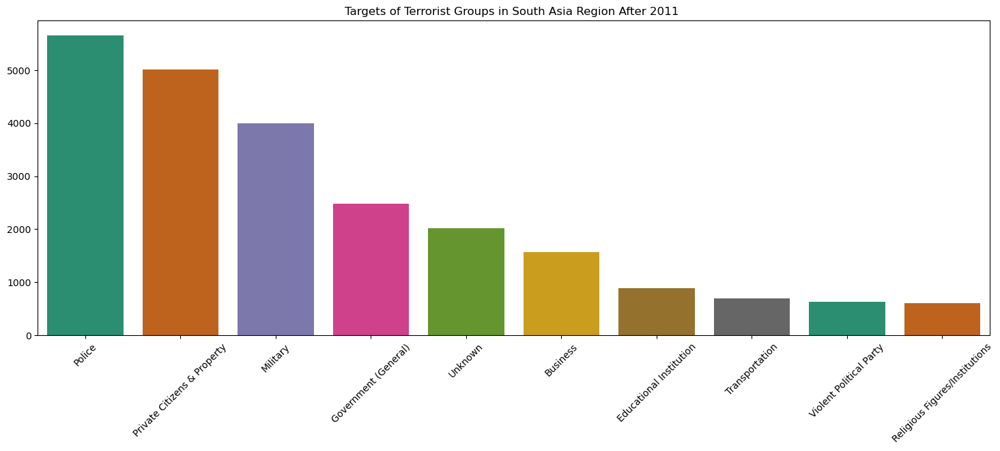

In [99]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.Target_type.value_counts()[:10].index, y=df2_region.Target_type.value_counts()[:10].values, palette='Dark2')
plt.title('Targets of Terrorist Groups in South Asia Region After 2011 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) We can clearly see that Terrorists started targetting Police and Military more aggresively in South Asia region after 2011. 

2) There was a slight decrease in  the number of attacks on Government Organisations and Transportaions after 2011.


3) No of attacks on Religious and Educational Institutions increased after 2011.

## <span style="color: brown;">  Overall </span>

In [100]:
df_region= df[df.Region == 'South Asia']
df_region.Target_type.value_counts()[:10]

Private Citizens & Property       10491
Police                             8471
Military                           5696
Government (General)               5463
Business                           3123
Unknown                            2402
Transportation                     2112
Educational Institution            1781
Religious Figures/Institutions     1141
Violent Political Party            1106
Name: Target_type, dtype: int64

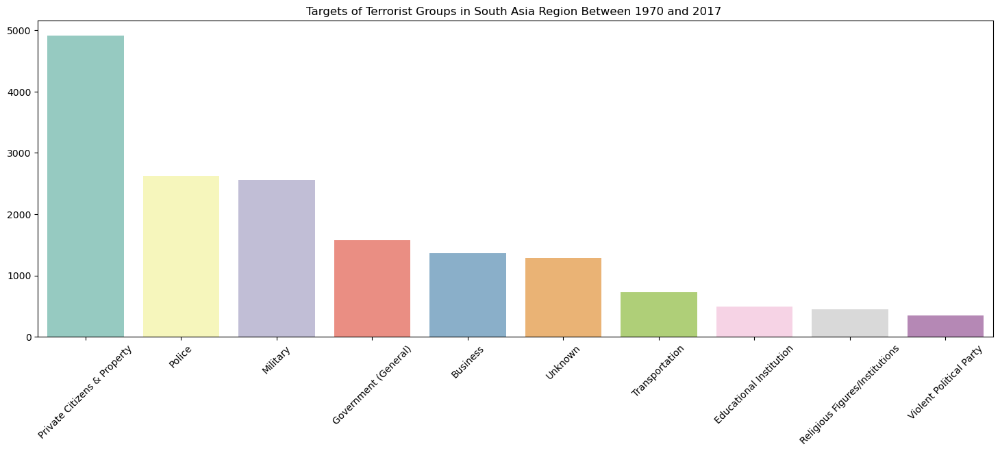

In [119]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.Target_type.value_counts()[:10].index, y=df3_region.Target_type.value_counts()[:10].values, palette='Set3')
plt.title('Targets of Terrorist Groups in South Asia Region Between 1970 and 2017 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

Overall we can conclude that Private Citizens & Property, Police, Military , Government, Business were the main targets of Terrorists in South Asian region between 1970-2017.

## <span style="color: teal"> Whaich  Terrorist Group had  carried out the most terrorist attacks in South Asia ?</span>

## <span style="color: brown;">  Before 2011 </span>

In [112]:
df3_region= df3[df3.Region == 'South Asia']
df3_region.Group.value_counts()[:20]

Unknown                                           7728
Liberation Tigers of Tamil Eelam (LTTE)           1604
Taliban                                           1446
Communist Party of India - Maoist (CPI-Maoist)    1050
Sikh Extremists                                    711
People's Liberation Front (JVP)                    433
Tehrik-i-Taliban Pakistan (TTP)                    430
Maoists                                            260
United Liberation Front of Assam (ULFA)            235
Tamils                                             217
Muttahida Qami Movement (MQM)                      170
Muslim Militants                                   136
Muslim Separatists                                 118
Shanti Bahini - Peace Force                         99
Lashkar-e-Taiba (LeT)                               98
People's War Group (PWG)                            97
Separatists                                         88
Bodo Militants                                      87
Opposition

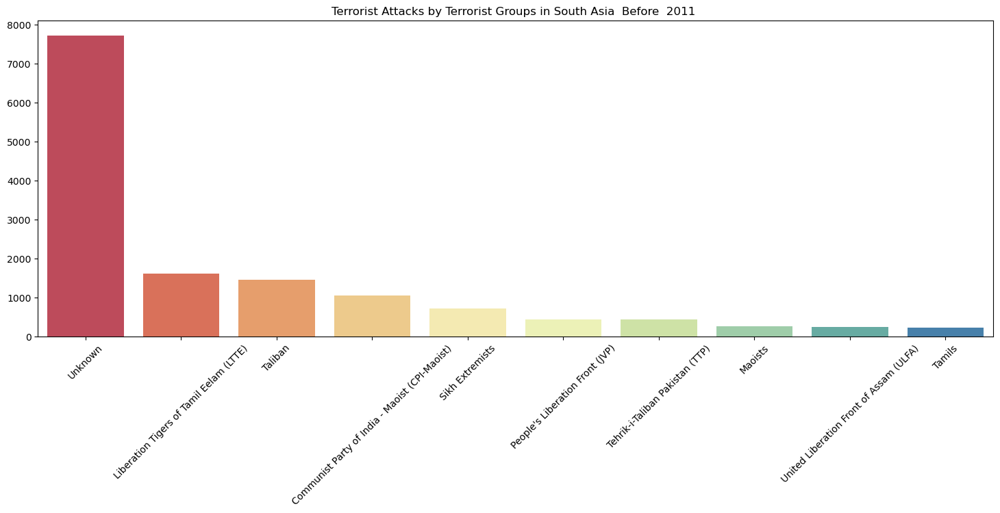

In [108]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.Group.value_counts()[:10].index, y=df3_region.Group.value_counts()[:10].values, palette='Spectral')
plt.title('Terrorist Attacks by Terrorist Groups in South Asia  Before  2011 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Unknown terrorist groups( with 7728 attacks) had carried out the most terrorist attacks in South- Asia in between 1970-2011.

2) From known terrorist  groups, Liberation Tigers Of Tamil Eelam (with 1604 atatcks), Taliabn (with 1446 attacks), Communist Party of India - Maoist ( with  1050 atatcks) had carried out the most terrorist attacks, 2nd most terrorist attacks and 3rd most terrorist attacks by Known terrorist groups in South Asia in between 1970-2011.

## <span style="color: brown;">  After 2011 </span>

In [111]:
df2_region= df2[df2.Region == 'South Asia']
df2_region.Group.value_counts()[:20]

Unknown                                                 13078
Taliban                                                  5817
Maoists                                                  1330
Tehrik-i-Taliban Pakistan (TTP)                           799
Communist Party of India - Maoist (CPI-Maoist)            457
Khorasan Chapter of the Islamic State                     343
Baloch Republican Army (BRA)                              263
Baloch Liberation Front (BLF)                             178
Garo National Liberation Army                             141
Baloch Liberation Army (BLA)                              118
United Liberation Front of Assam (ULFA)                   114
Hizbul Mujahideen (HM)                                    114
Lashkar-e-Jhangvi                                         106
Pro Hartal Activists                                       92
Communist Party of Nepal - Maoist (CPN-Maoist-Chand)       91
Lashkar-e-Taiba (LeT)                                      90
Lashkar-

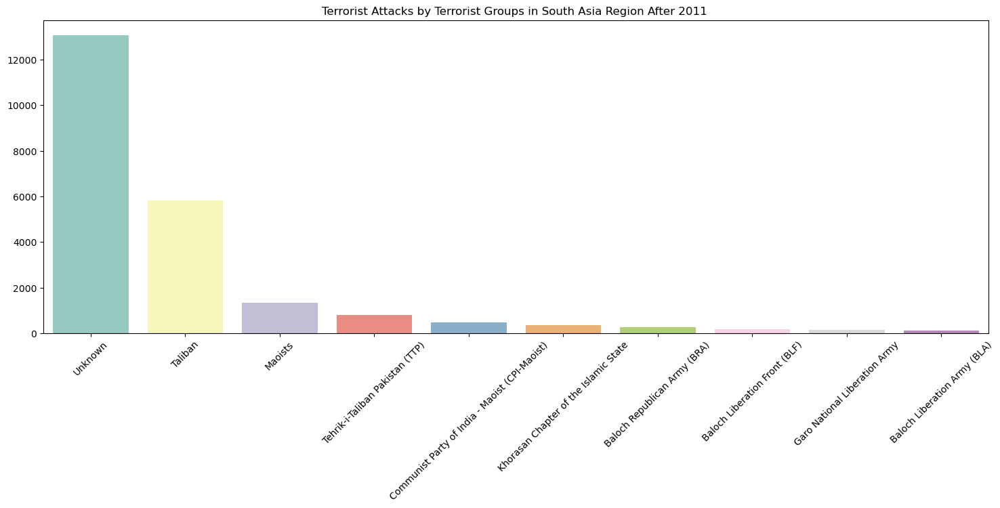

In [114]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.Group.value_counts()[:10].index, y=df2_region.Group.value_counts()[:10].values, palette='Set3')
plt.title('Terrorist Attacks by Terrorist Groups in South Asia Region After 2011 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Unknown terrorist groups( with 13078 attacks) had carried out the most terrorist attacks in South- Asia in between 2011-2017.

2) From known terrorist groups, Talibann (with 5887 attacks),  Maoist ( with  1330 atatcks),Tehrik-i-Taliban Pakistan /TTP        (with 799 attacks) had carried out the most terrorist attacks, 2nd most terrorist attacks and 3rd most terrorist attacks by Known terrorist groups in South Asia in between 2011-2017.

3) After 2011, there is a huge decline in the no of terrorist attacks by  Liberation Tigers Of Tamil Eelam and Communist Party of India - Maoist.

4) TWe can also conclude that there is a rise of some other terrorist groups after 2011.

## <span style="color: brown;"> Overall </span>

In [115]:
df_region= df[df.Region == 'South Asia']
df_region.Group.value_counts()[:20]

Unknown                                           21913
Taliban                                            7477
Communist Party of India - Maoist (CPI-Maoist)     1878
Maoists                                            1625
Liberation Tigers of Tamil Eelam (LTTE)            1604
Tehrik-i-Taliban Pakistan (TTP)                    1350
Sikh Extremists                                     712
People's Liberation Front (JVP)                     433
United Liberation Front of Assam (ULFA)             357
Khorasan Chapter of the Islamic State               343
Baloch Republican Army (BRA)                        312
Tamils                                              217
Hizbul Mujahideen (HM)                              199
Lashkar-e-Taiba (LeT)                               190
Baloch Liberation Front (BLF)                       185
Baloch Liberation Army (BLA)                        181
National Democratic Front of Bodoland (NDFB)        175
Muttahida Qami Movement (MQM)                   

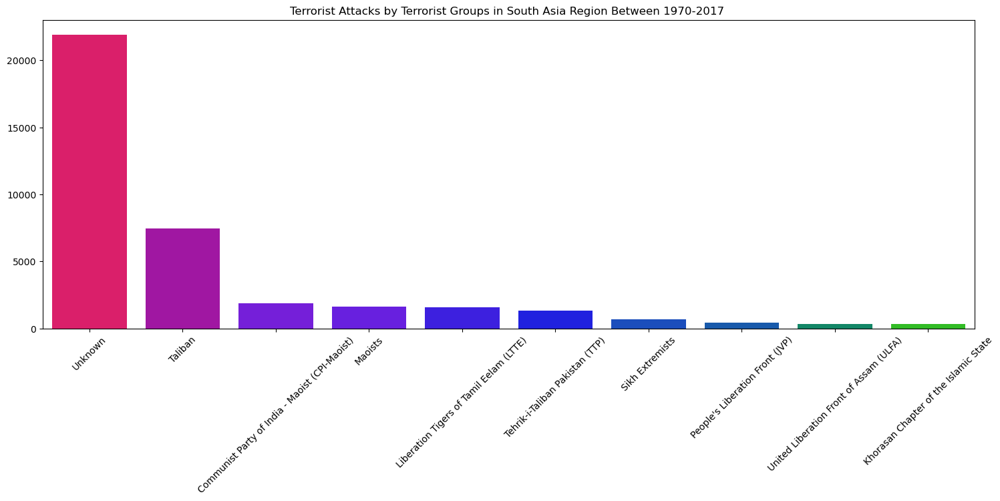

In [118]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.Group.value_counts()[:10].index, y=df_region.Group.value_counts()[:10].values, palette='prism')
plt.title('Terrorist Attacks by Terrorist Groups in South Asia Region Between 1970-2017 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Unknown terrorist groups( with 21913 attacks) had carried out the most terrorist attacks in South- Asia in between 2011-2017.

2) From known terrorist groups, Taliban (with 7477 attacks), CPI-Maoist ( with  1878 atatcks),Maoists (with 1625 attacks),Liberation Tigers of Tamil Eelam/LTTE ( with 1605 attacks)Tehrik-i-Taliban Pakistan /TTP (with 1350 attacks) had carried out the most terrorist attacks, 2nd most terrorist attacks , 3rd most terrorist attacks,4th most terrorist attacks and 5th most terrorist attacks  by Known terrorist groups respectively  in South Asia Region in between 1970-2017.

# <span style="color: olive;">Analysis Of South America region </span>

##  <span style="color: teal;">Which Countries In South America region had faced most terrorist attacks ?</span>

## <span style="color: brown"> Before 2011 </span>

In [124]:
df3_region= df3[df3.Region == 'South America']
df3_region.Country.value_counts()

Colombia            7355
Peru                6047
Chile               2304
Argentina            803
Bolivia              313
Venezuela            261
Brazil               257
Ecuador              210
Uruguay               81
Suriname              66
Paraguay              37
Guyana                25
French Guiana          7
Falkland Islands       1
Name: Country, dtype: int64

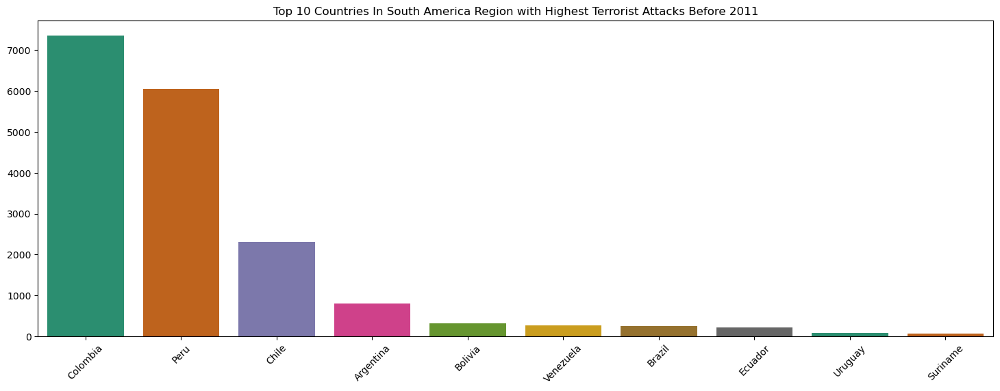

In [122]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.Country.value_counts()[:10].index, y=df3_region.Country.value_counts()[:10].values, palette='Dark2')
plt.title('Top 10 Countries In South America Region with Highest Terrorist Attacks Before 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Colombia and Peru were the two countries which faced more than 6000+ terrorist attacks in the South America region in between 1970-2017.

2) After Colombia and Peru, Chile is the only country which faced more than 1000+ terrorist attacks in South America region in between 1970-2017.

3) French Guiana  and Falkland Islands are the only countries which faced less than 10 terrorist attacks in South America region in between 1970-2017.

## <span style="color: brown"> After 2011 </span>

In [125]:
df2_region= df2[df2.Region == 'South America']
df2_region.Country.value_counts()

Colombia     857
Paraguay      73
Chile         55
Peru          49
Venezuela     32
Brazil        16
Argentina     11
Ecuador        9
Bolivia        1
Uruguay        1
Guyana         1
Name: Country, dtype: int64

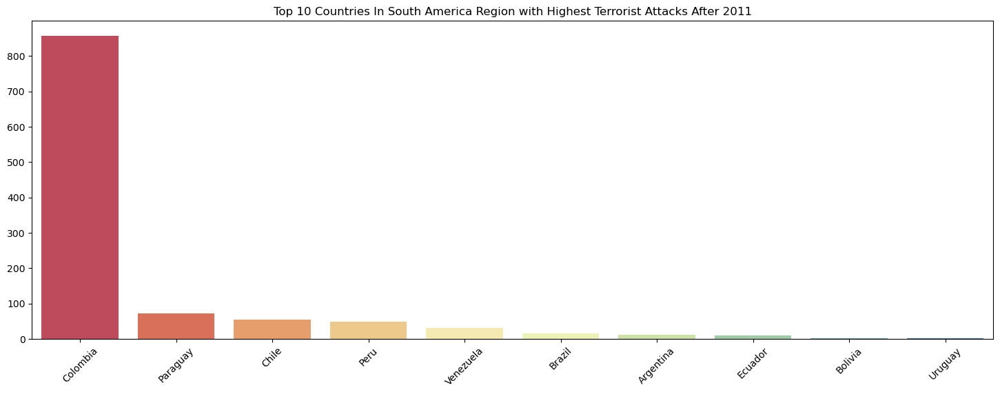

In [132]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.Country.value_counts()[:10].index, y=df2_region.Country.value_counts()[:10].values, palette='Spectral')
plt.title('Top 10 Countries In South America Region with Highest Terrorist Attacks After 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Colombia is the only country in South America region which faced more than 100+ terrorist attacks after 2011 which is still very less compared to the no of terrorist attacks faced by Colombia during 1970-2011.

2.  Number of terrorist attacks significantly decreased in Peru ,Chile, Ecuador Argentina, Brazil and Venezuela.

3. Number of terrorist attacks slightly increased in Paraguay.

## <span style="color: brown"> Overall </span>

In [131]:
df_region= df[df.Region == 'South America']
df_region.Country.value_counts()

Colombia            8306
Peru                6096
Chile               2365
Argentina            815
Bolivia              314
Venezuela            293
Brazil               273
Ecuador              220
Paraguay             114
Uruguay               82
Suriname              66
Guyana                26
French Guiana          7
Falkland Islands       1
Name: Country, dtype: int64

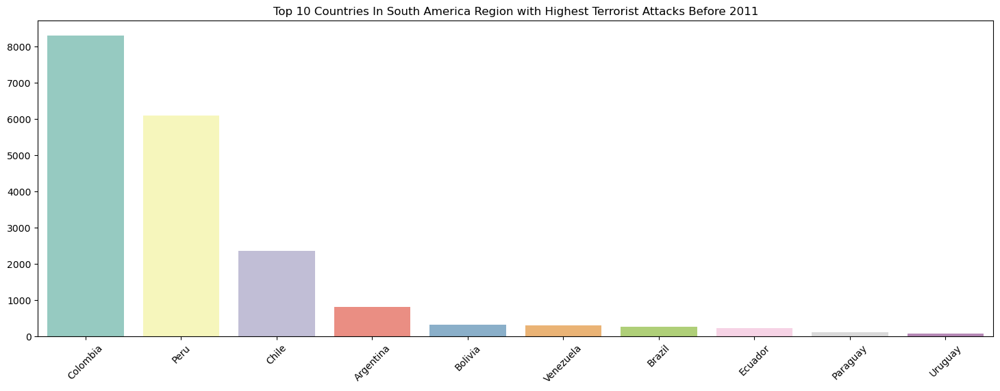

In [134]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.Country.value_counts()[:10].index, y=df_region.Country.value_counts()[:10].values, palette='Set3')
plt.title('Top 10 Countries In South America Region with Highest Terrorist Attacks Before 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Colombia and Peru are the only countries in South America region which faced more than 6000+ terrorist attacks in between 1970-2017.

2) Apart from Colombia and Peru, Chile is the only country in South America region which faced more than 1000+ attacks in between 1970-2017.

## <span style="color: teal;"> Which methods were used by Terrorist Groups to spread terrorism in South America Region?</span>

## <span style="color: brown"> Before 2011 </span>

In [136]:
df3_region= df3[df3.Region == 'South America']
df3_region.AttackType.value_counts()[:10]

Bombing/Explosion                      8450
Armed Assault                          3656
Assassination                          2676
Hostage Taking (Kidnapping)            1272
Unknown                                 699
Facility/Infrastructure Attack          679
Hostage Taking (Barricade Incident)     225
Hijacking                                65
Unarmed Assault                          45
Name: AttackType, dtype: int64

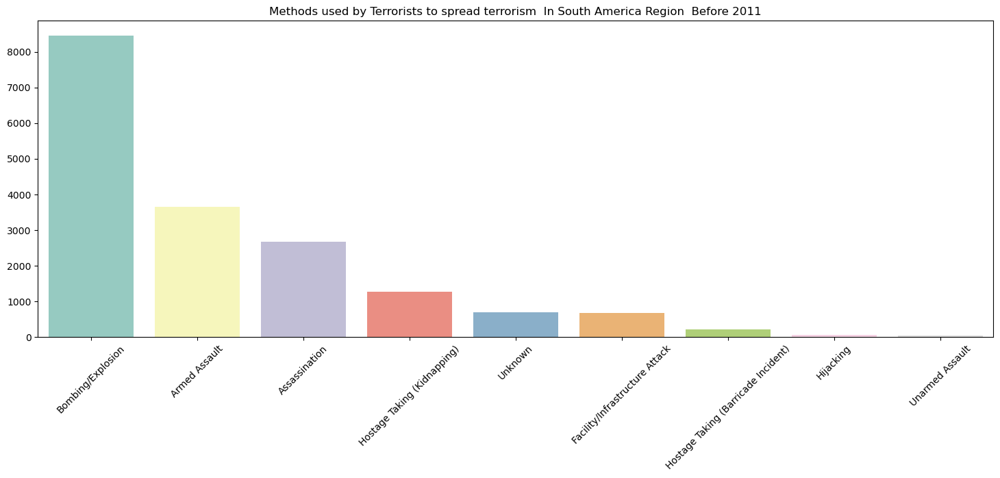

In [147]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.AttackType.value_counts()[:10].index, y=df3_region.AttackType.value_counts()[:10].values, palette='Set3')
plt.title('Methods used by Terrorists to spread terrorism  In South America Region  Before 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: brown"> After 2011 </span>

In [143]:
df2_region= df2[df2.Region == 'South America']
df2_region.AttackType.value_counts()[:20]

Bombing/Explosion                      523
Armed Assault                          206
Hostage Taking (Kidnapping)            134
Facility/Infrastructure Attack         111
Assassination                           66
Unknown                                 53
Hostage Taking (Barricade Incident)      9
Unarmed Assault                          2
Hijacking                                1
Name: AttackType, dtype: int64

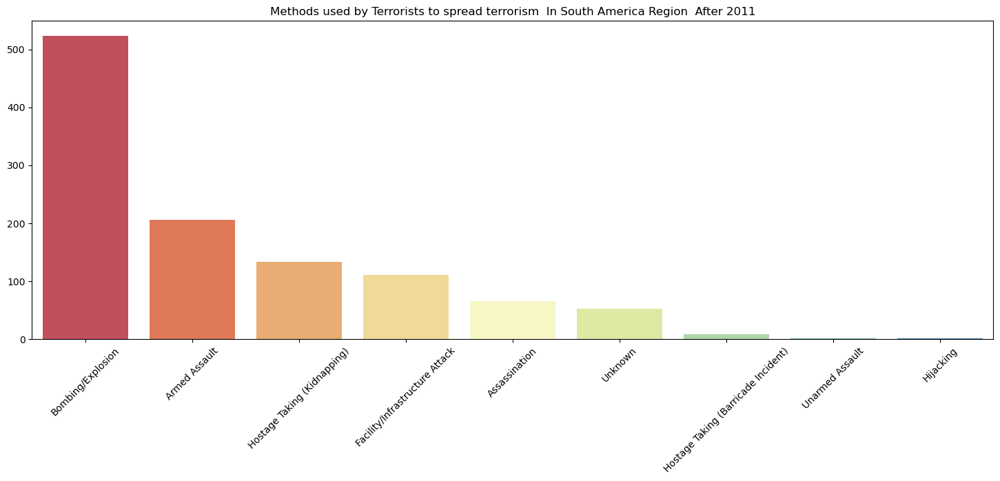

In [146]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.AttackType.value_counts()[:10].index, y=df2_region.AttackType.value_counts()[:10].values, palette='Spectral')
plt.title('Methods used by Terrorists to spread terrorism  In South America Region  After 2011')
plt.xticks(rotation=45)
plt.show()

## <span style="color: brown"> Overall </span>

In [145]:
df_region= df[df.Region == 'South America']
df_region.AttackType.value_counts()[:20]

Bombing/Explosion                      9039
Armed Assault                          3875
Assassination                          2745
Hostage Taking (Kidnapping)            1414
Facility/Infrastructure Attack          803
Unknown                                 754
Hostage Taking (Barricade Incident)     234
Hijacking                                67
Unarmed Assault                          47
Name: AttackType, dtype: int64

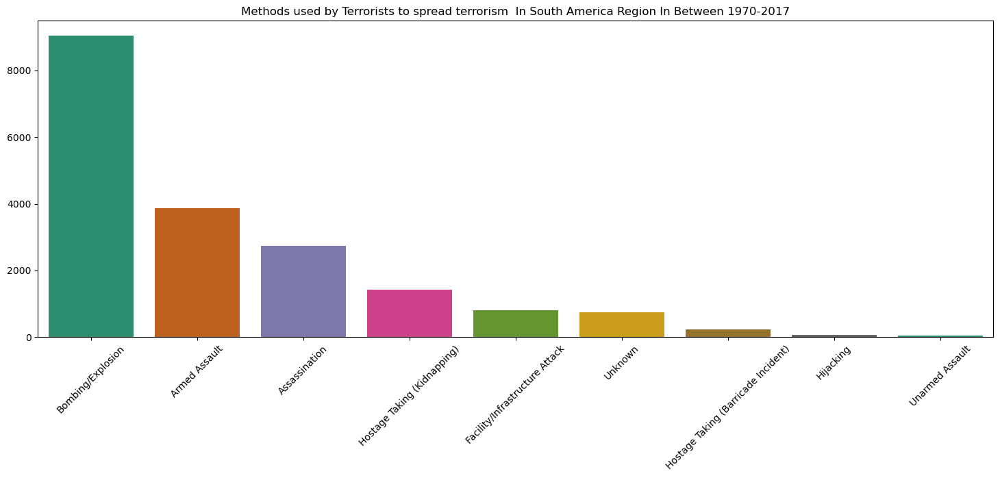

In [161]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.AttackType.value_counts().index, y=df_region.AttackType.value_counts().values, palette='Dark2')
plt.title('Methods used by Terrorists to spread terrorism  In South America Region In Between 1970-2017')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

1) Terrorists mostly preffered Bombing/Explosion and Armed Assault to spread terrorism in South America region in between 1970 and 2017.

2) Terrorists also preffered Assasination and Hostage Taking/Kidnapping in few cases to spread terrorism in South America region in between 1970 and 2017.

## <span style="color: teal;"> Who were targetted by Terrorist Groups in South America Region?</span>

## <span style="color: brown"> Before 2011 </span>

In [158]:
df3_region= df3[df3.Region == 'South America']
df3_region.Target_type.value_counts()

Business                          3332
Private Citizens & Property       2996
Government (General)              2783
Police                            2026
Utilities                         1741
Military                          1571
Transportation                    1013
Journalists & Media                540
Government (Diplomatic)            383
Educational Institution            348
Religious Figures/Institutions     337
Airports & Aircraft                142
Telecommunication                  141
Unknown                            115
Food or Water Supply                75
Terrorists/Non-State Militia        74
NGO                                 57
Tourists                            34
Maritime                            29
Violent Political Party             28
Abortion Related                     1
Other                                1
Name: Target_type, dtype: int64

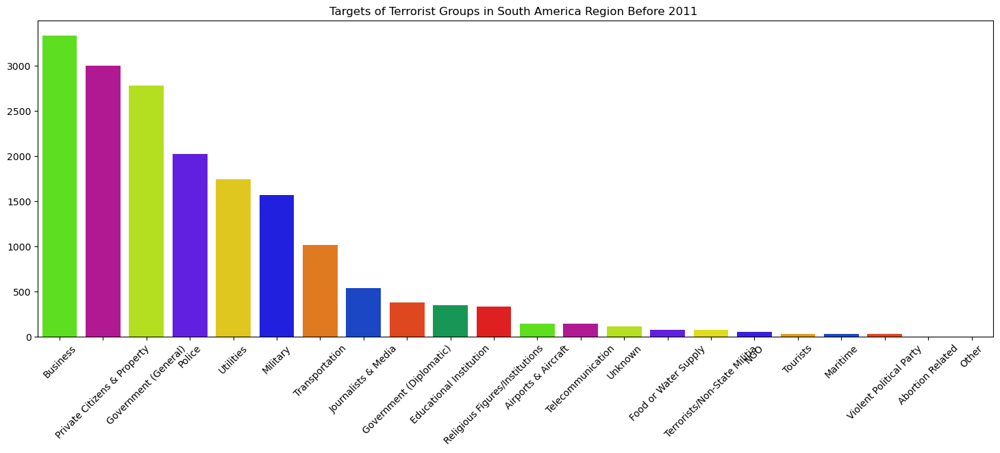

In [159]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df3_region.Target_type.value_counts().index, y=df3_region.Target_type.value_counts().values, palette='prism')
plt.title('Targets of Terrorist Groups in South America Region Before 2011 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

In South American Region,Business, Private Citizens & Property, Government Organisations were the top 3 targets of terrorists before 2011.

In [165]:
## <span style="color: brown"> After 2011 </span>

In [166]:
df2_region= df2[df2.Region == 'South America']
df2_region.Target_type.value_counts()[:20]

Police                            222
Military                          193
Utilities                         171
Business                          140
Private Citizens & Property       131
Transportation                     58
Government (General)               53
Unknown                            50
Journalists & Media                40
Religious Figures/Institutions     12
Government (Diplomatic)             7
Tourists                            5
Food or Water Supply                5
Educational Institution             5
Airports & Aircraft                 4
Terrorists/Non-State Militia        4
Telecommunication                   3
NGO                                 2
Name: Target_type, dtype: int64

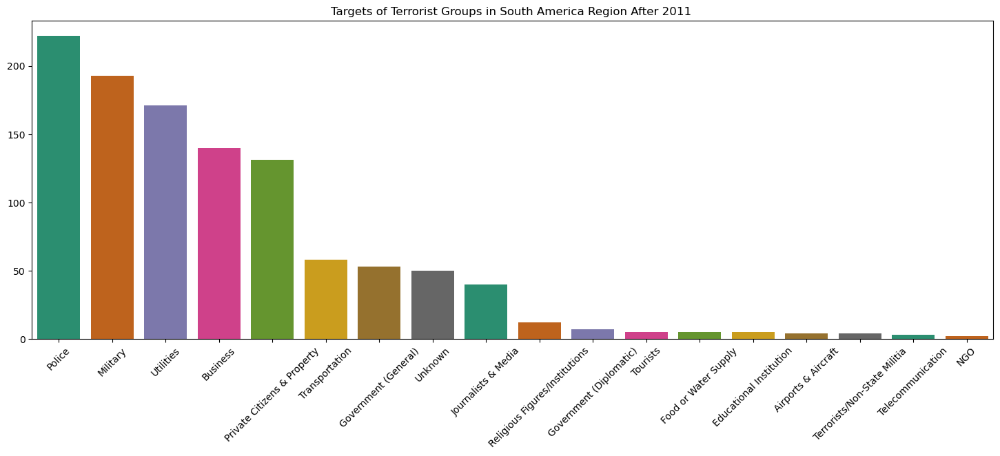

In [164]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df2_region.Target_type.value_counts().index, y=df2_region.Target_type.value_counts().values, palette='Dark2')
plt.title('Targets of Terrorist Groups in South America Region After 2011 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

While no of terrorist attacks significantly reduced after 2011,  Police, Military, Utilities  were the top 3 targets of terrorists in South America Region after 2011.

## <span style="color: brown;">Overall:- </span>

In [167]:
df_region= df[df.Region == 'South America']
df_region.Target_type.value_counts()

Business                          3494
Private Citizens & Property       3152
Government (General)              2849
Police                            2256
Utilities                         1930
Military                          1770
Transportation                    1080
Journalists & Media                583
Government (Diplomatic)            390
Educational Institution            354
Religious Figures/Institutions     349
Unknown                            165
Airports & Aircraft                146
Telecommunication                  144
Food or Water Supply                80
Terrorists/Non-State Militia        78
NGO                                 59
Tourists                            39
Maritime                            30
Violent Political Party             28
Abortion Related                     1
Other                                1
Name: Target_type, dtype: int64

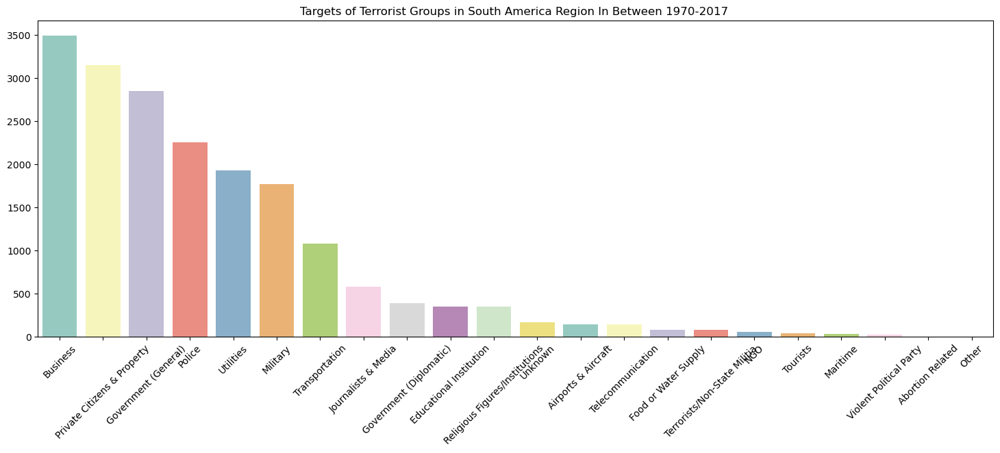

In [169]:
plt.subplots(figsize=(18, 6))
sns.barplot(x=df_region.Target_type.value_counts().index, y=df_region.Target_type.value_counts().values, palette='Set3')
plt.title('Targets of Terrorist Groups in South America Region In Between 1970-2017 ')
plt.xticks(rotation=45)
plt.show()

## <span style="color: maroon;">Observations:- </span>

Business , Private Citizens & Property, Government, Police, Utilities, Military and Transportation were the top targets of terrorists in South America region during 1970-2017.

In [ ]:
## <span style="color: teal"> Whaich  Terrorist Group had  carried out the most terrorist attacks in South Asia ?</span>